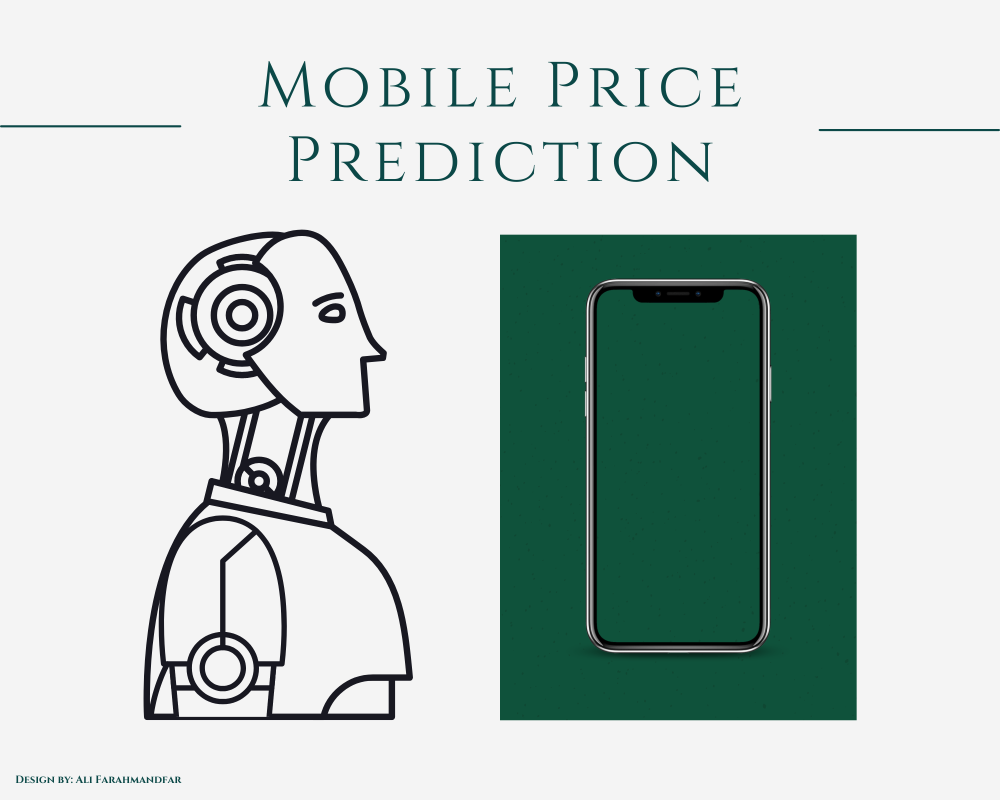

<a class="anchor" id="About_Data"></a>
# <p style="padding:10px;background-color:#2e5551;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 15px 50px;overflow:hidden;font-weight:500">About Data</p> 

<div style="background-color:#d5eae9; padding:20px; font-size:15px">

**Content:** 

The price of a cell phone, which has become a necessity in our daily lives, varies widely depending on its specifications. In this notebook, we will explore the factors that affect cell phone prices and predict new samples based on the best model.

**This notebook includes the following:**

- Preprocessing
- Data cleaning
- Exploratory data analysis (EDA)
- Preparing the data to train a model
- Training and making predictions using various classification models
- Model evaluation
- Using various ensemble learning methods
    
**Objective:**   
    
Our objective is to predict the price range of a mobile phone by building a model that takes into account various features provided in the dataset. We will be using supervised learning methods such as **Decision Trees (DTs)**, **Random Forest**, and **Support Vector Machine (SVM)** to determine the best model for this problem.

<div style="background-color:#d5eae9; padding:20px; font-size:15px">
    <strong>What Problem We Have?</strong> 
    <br>
    
Our task is to perform a classification on the target variable "Price Range" based on the data and attribute information. To achieve the best possible classification, we will develop a model that accurately predicts the price range of mobile phones.

<div style="background-color:#d5eae9; padding:20px; font-size:15px">

|       | **Attribute** | **Information** |
| :---  |     :---      |       :---      |      
| **1** | battery_power | Total energy a battery can store in one time measured in (mAh) |                
| **2** | blue | Has bluetooth or not |                        
| **3** | clock_speed | Speed at which microprocessor executes instructions |
| **4** | dual_sim | Has dual sim support or not |
| **5** | fc | Front camera (Megapixels) |                     
| **6** | four_g | Has 4G or not |
| **7** | int_memory | Internal memory in (Gigabytes) |              
| **8** | m_dep | Mobile depth in (Cm)  |                      
| **9** | mobile_wt |  Weight of mobile phone |
| **10** | pc | Primary camera (Megapixels) |
| **11** | px_height | Pixel resolution height |                      
| **12** | px_width | Pixel resolution width |
| **13** | ram | Random access memory in (Megabytes)  |              
| **14** | sc_h | Screen height of mobile in (Cm)  |                      
| **15** | sc_w | Screen width of mobile in (Cm) |
| **16** | talk_time | Longest time that a single battery charge will last when you are constantly talking on the phone |
| **17** | three_g | Has 3G or not |                      
| **18** | touch_screen | Has touch screen or not | 
| **19** | wifi | Has wifi or not |              
| **20** | n_cores | Number of cores of processor |                       
| **21** | **price_range** | This is the Target variable with value of **0: (Low Cost**), **1: (Medium Cost**), **2: (High Cost**), and **3: (Very High Cost**) |

<a id="1"></a>  
# <p style="padding:10px;background-color:#2e5551;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 15px 50px;overflow:hidden;font-weight:500">1. Import Libraries</p>

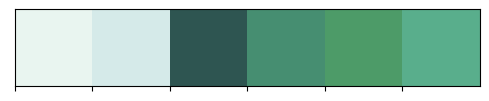

In [1]:
# Data
import pandas as pd
import numpy as np

# Pandas Profiling
from ydata_profiling import ProfileReport

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import tree

# Train Test Split
from sklearn.model_selection import train_test_split

# Algorithms
from sklearn.tree import DecisionTreeClassifier 
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC

# GridSearchCV
from sklearn.model_selection import GridSearchCV

# KFold
from sklearn.model_selection import RepeatedStratifiedKFold

# Validation
from sklearn.model_selection import cross_val_predict

# Scaling
from sklearn.preprocessing import StandardScaler

# Metrics
from sklearn import metrics
from sklearn.metrics import confusion_matrix, auc, roc_curve
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import PrecisionRecallDisplay, RocCurveDisplay
from sklearn.metrics import ConfusionMatrixDisplay, classification_report
from statistics import stdev

# Ensembling
from sklearn.ensemble import VotingClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
import xgboost as xg

# Supress warnings
import warnings
warnings.filterwarnings('ignore')

#color pallet and theme
import matplotlib.colors

colors = ["#e9f5f0","#d5eae9","#2e5551",'#468e71','#4d9b68','#59ae8c']
colors2 = ["#2e5551",'#468e71','#4d9b68','#59ae8c', "#e9f5f0","#d5eae9"]
cmap = matplotlib.colors.ListedColormap(colors2)

sns.palplot(sns.color_palette(colors))

<a id="1"></a>  
# <p style="padding:10px;background-color:#2e5551;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 15px 50px;overflow:hidden;font-weight:500">2. Reading and Understanding the Dataset</p>

<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">2.1. Import Dataset</p>

In [2]:
Data = pd.read_csv('E:/train.csv')

In [3]:
test = pd.read_csv('E:/test.csv')

In [4]:
# Preview the dataset (train)
Df = pd.DataFrame(Data)
Df.head(5)

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,842,0,2.2,0,1,0,7,0.6,188,2,...,20,756,2549,9,7,19,0,0,1,1
1,1021,1,0.5,1,0,1,53,0.7,136,3,...,905,1988,2631,17,3,7,1,1,0,2
2,563,1,0.5,1,2,1,41,0.9,145,5,...,1263,1716,2603,11,2,9,1,1,0,2
3,615,1,2.5,0,0,0,10,0.8,131,6,...,1216,1786,2769,16,8,11,1,0,0,2
4,1821,1,1.2,0,13,1,44,0.6,141,2,...,1208,1212,1411,8,2,15,1,1,0,1


In [5]:
# Preview the dataset (test)
Df_test = pd.DataFrame(test)
Df_test.head(5)

,id,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,...,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi
0,1,1043,1,1.8,1,14,0,5,0.1,193,...,16,226,1412,3476,12,7,2,0,1,0
1,2,841,1,0.5,1,4,1,61,0.8,191,...,12,746,857,3895,6,0,7,1,0,0
2,3,1807,1,2.8,0,1,0,27,0.9,186,...,4,1270,1366,2396,17,10,10,0,1,1
3,4,1546,0,0.5,1,18,1,25,0.5,96,...,20,295,1752,3893,10,0,7,1,1,0
4,5,1434,0,1.4,0,11,1,49,0.5,108,...,18,749,810,1773,15,8,7,1,0,1


<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">2.2. Discover Data (train)</p>

In [6]:
# View dimensions of dataset   
rows, col = Df.shape
print ("Dimensions of dataset: {}" . format (Df.shape))
print ('Rows:', rows, '\nColumns:', col)

Dimensions of dataset: (2000, 21)
Rows: 2000 
Columns: 21


In [7]:
# Statistical details
Df.iloc[:, :-1].describe().T.sort_values(by='std', ascending = False)\
                          .style.background_gradient(cmap="Greens")\
                          .bar(subset=["max"], color='#F8766D')\
                          .bar(subset=["mean"], color='#00BFC4')

,count,mean,std,min,25%,50%,75%,max
ram,2000.000000,2124.213000,1084.732044,256.000000,1207.500000,2146.500000,3064.500000,3998.000000
px_height,2000.000000,645.108000,443.780811,0.000000,282.750000,564.000000,947.250000,1960.000000
battery_power,2000.000000,1238.518500,439.418206,501.000000,851.750000,1226.000000,1615.250000,1998.000000
px_width,2000.000000,1251.515500,432.199447,500.000000,874.750000,1247.000000,1633.000000,1998.000000
mobile_wt,2000.000000,140.249000,35.399655,80.000000,109.000000,141.000000,170.000000,200.000000
int_memory,2000.000000,32.046500,18.145715,2.000000,16.000000,32.000000,48.000000,64.000000
pc,2000.000000,9.916500,6.064315,0.000000,5.000000,10.000000,15.000000,20.000000
talk_time,2000.000000,11.011000,5.463955,2.000000,6.000000,11.000000,16.000000,20.000000
sc_w,2000.000000,5.767000,4.356398,0.000000,2.000000,5.000000,9.000000,18.000000
fc,2000.000000,4.309500,4.341444,0.000000,1.000000,3.000000,7.000000,19.000000


<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
    <strong>The overhead table (train) displays:</strong> 
    <br>

- Each feature contains **2000** data recorded. 
- There are some numerical features in the dataset including **m_dep, px height, and sc_w** that their **min** values **don't make sense**.

In [8]:
# Number of uniqe elements in each columns
unique = Df.nunique()
unique.to_frame().T

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_range
0,1094,2,26,2,20,2,63,10,121,8,...,1137,1109,1562,15,19,19,2,2,2,4


In [9]:
# Information about the dataframe
Df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   battery_power  2000 non-null   int64  
 1   blue           2000 non-null   int64  
 2   clock_speed    2000 non-null   float64
 3   dual_sim       2000 non-null   int64  
 4   fc             2000 non-null   int64  
 5   four_g         2000 non-null   int64  
 6   int_memory     2000 non-null   int64  
 7   m_dep          2000 non-null   float64
 8   mobile_wt      2000 non-null   int64  
 9   n_cores        2000 non-null   int64  
 10  pc             2000 non-null   int64  
 11  px_height      2000 non-null   int64  
 12  px_width       2000 non-null   int64  
 13  ram            2000 non-null   int64  
 14  sc_h           2000 non-null   int64  
 15  sc_w           2000 non-null   int64  
 16  talk_time      2000 non-null   int64  
 17  three_g        2000 non-null   int64  
 18  touch_sc

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
    <strong>The information of the train data shows:</strong> 
    <br>

- **clock_speed** and **m_dep** has an **float64** type and the rest of the features have an **int64** type.

<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">2.3. Discover Data (test)</p>

In [10]:
# View dimensions of dataset   
rows, col = Df_test.shape
print ("Dimensions of dataset: {}" . format (Df_test.shape))
print ('Rows:', rows,'\nColumns:', col)

Dimensions of dataset: (1000, 21)
Rows: 1000 
Columns: 21


In [11]:
# Statistical details
Df_test.iloc[:, :-1].describe().T.sort_values(by='std' , ascending = False)\
                     .style.background_gradient(cmap='Greens')\
                     .bar(subset=["max"], color='#F8766D')\
                     .bar(subset=["mean",], color='#00BFC4')

,count,mean,std,min,25%,50%,75%,max
ram,1000.000000,2138.998000,1088.092278,263.000000,1237.250000,2153.500000,3065.500000,3989.000000
px_width,1000.000000,1239.774000,439.670981,501.000000,831.750000,1250.000000,1637.750000,1998.000000
px_height,1000.000000,627.121000,432.929699,0.000000,263.750000,564.500000,903.000000,1907.000000
battery_power,1000.000000,1248.510000,432.458227,500.000000,895.000000,1246.500000,1629.250000,1999.000000
id,1000.000000,500.500000,288.819436,1.000000,250.750000,500.500000,750.250000,1000.000000
mobile_wt,1000.000000,139.511000,34.851550,80.000000,109.750000,139.000000,170.000000,200.000000
int_memory,1000.000000,33.652000,18.128694,2.000000,18.000000,34.500000,49.000000,64.000000
pc,1000.000000,10.054000,6.095099,0.000000,5.000000,10.000000,16.000000,20.000000
talk_time,1000.000000,11.085000,5.497636,2.000000,6.750000,11.000000,16.000000,20.000000
fc,1000.000000,4.593000,4.463325,0.000000,1.000000,3.000000,7.000000,19.000000


<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
    <strong>The overhead table (test) displays:</strong> 
    <br>

- Each feature contains **1000** data recorded. 
- There are some numerical features in the dataset including **m_dep, px height, and sc_w** that their **min** values **don't make sense**.

In [12]:
# Information about the dataframe
Df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             1000 non-null   int64  
 1   battery_power  1000 non-null   int64  
 2   blue           1000 non-null   int64  
 3   clock_speed    1000 non-null   float64
 4   dual_sim       1000 non-null   int64  
 5   fc             1000 non-null   int64  
 6   four_g         1000 non-null   int64  
 7   int_memory     1000 non-null   int64  
 8   m_dep          1000 non-null   float64
 9   mobile_wt      1000 non-null   int64  
 10  n_cores        1000 non-null   int64  
 11  pc             1000 non-null   int64  
 12  px_height      1000 non-null   int64  
 13  px_width       1000 non-null   int64  
 14  ram            1000 non-null   int64  
 15  sc_h           1000 non-null   int64  
 16  sc_w           1000 non-null   int64  
 17  talk_time      1000 non-null   int64  
 18  three_g  

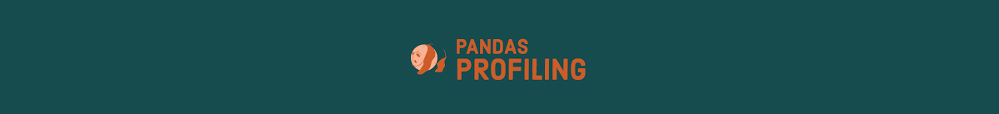

#### 🎄Train Data

In [13]:
#profile_train = ProfileReport(Df, title="Pandas Profiling Report on train data", explorative=True)

In [14]:
#profile_train.to_widgets()

#### 🎄Test Data

In [15]:
#profile_test = ProfileReport(Df_test, title="Pandas Profiling Report on train data", explorative=True)

In [16]:
#profile_test.to_widgets()

<a id="1"></a>  
# <p style="padding:10px;background-color:#2e5551;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 15px 50px;overflow:hidden;font-weight:500">3. Preprocessing</p>

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">

🔍Because some numeric features in the dataset, including **m_dep, px height, and sc_w**, whose minimum values did not make sense, should be investigated more deeply.

#### 🎄Mobile Depth (Cm):

In [17]:
Df.m_dep.describe()

count    2000.000000
mean        0.501750
std         0.288416
min         0.100000
25%         0.200000
50%         0.500000
75%         0.800000
max         1.000000
Name: m_dep, dtype: float64

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">

- ✅According to the text as well as the reference below, I will consider the **minimum Mobile Depth** to be **0.5 centimeters**.

The minimum range of mobile phone depth varies depending on the manufacturer, model, and specific phone design. However, most smartphones have a thickness (depth) in the range of **7mm to 10mm**. Some high-end models may be thinner than this range, with depths as low as **6mm or even less**.

🔍[Reference](https://www.techrankup.com/en/smartphones-thickness-ranking/)

#### 🎄Pixel Resolution (Height):

In [18]:
Df.px_height.describe()

count    2000.000000
mean      645.108000
std       443.780811
min         0.000000
25%       282.750000
50%       564.000000
75%       947.250000
max      1960.000000
Name: px_height, dtype: float64

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">

- ✅I considered the dimensions of the **Nokia 1100 (96 x 65 pixels, 3:2 ratio)** as the **minimum of Pixel Resolution**.➡️ **65 pixels**

🔍[Reference](https://www.gsmarena.com/nokia_1100-512.php)

#### 🎄Screen Width (Cm):

In [19]:
Df.sc_w.describe()

count    2000.000000
mean        5.767000
std         4.356398
min         0.000000
25%         2.000000
50%         5.000000
75%         9.000000
max        18.000000
Name: sc_w, dtype: float64

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">

- ✅According to the **Nokia 1100 screen resolution (96 x 65 pixels, 3:2 ratio)**, I will consider the **minimum Screen Width** to be **1 inch = 2.54 centimeters**.

🔍[Reference](https://www.gsmarena.com/nokia_1100-512.php)

<a id="1"></a>  
# <p style="padding:10px;background-color:#2e5551;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 15px 50px;overflow:hidden;font-weight:500">4. Data Cleaning</p>

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
    
Let's first address what we discussed in the data preprocessing section.

<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">🎄Mobile Depth</p>

#### 🎄Train Data

In [20]:
# Find values below 0.5 cm
below_threshold = Df["m_dep"][Df["m_dep"] < 0.5]

# Count the number of values below 0.5 cm
num_below_threshold = len(below_threshold)

# Print the number of values below 0.5 cm
print("Number of values below 0.5 cm in 'm_dep' feature: ", num_below_threshold)

Number of values below 0.5 cm in 'm_dep' feature:  900


In [21]:
# Replace values below 0.5 cm with 0.5 cm
Df["m_dep"][Df["m_dep"] < 0.5] = 0.5

In [22]:
Df.m_dep.describe()

count    2000.000000
mean        0.626000
std         0.165159
min         0.500000
25%         0.500000
50%         0.500000
75%         0.800000
max         1.000000
Name: m_dep, dtype: float64

#### 🎄Test Data

In [23]:
# Find values below 0.5 cm
below_threshold3 = Df_test["m_dep"][Df_test["m_dep"] < 0.5]

# Count the number of values below 0.5 cm
num_below_threshold3 = len(below_threshold3)

# Print the number of values below 0.5 cm
print("Number of values below 0.5 cm in 'm_dep' feature: ", num_below_threshold3)

Number of values below 0.5 cm in 'm_dep' feature:  418


In [24]:
# Replace values below 0.5 cm with 0.5 cm
Df_test["m_dep"][Df_test["m_dep"] < 0.5] = 0.5

In [25]:
Df_test.m_dep.describe()

count    1000.00000
mean        0.62880
std         0.16516
min         0.50000
25%         0.50000
50%         0.50000
75%         0.80000
max         1.00000
Name: m_dep, dtype: float64

<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">🎄Pixel Resolution</p>

#### 🎄Train Data

In [26]:
# Find values below 65 pixels
below_threshold1 = Df["px_height"][Df["px_height"] < 65]

# Count the number of values below 65 pixels
num_below_threshold1 = len(below_threshold1)

# Print the number of values below 65 pixels
print("Number of values below 65 pixels in 'px_height' feature: ", num_below_threshold1)

Number of values below 65 pixels in 'px_height' feature:  90


In [27]:
# Replace values below 65 pixels with 65 pixels
Df["px_height"][Df["px_height"] < 65] = 65

In [28]:
Df.px_height.describe()

count    2000.000000
mean      646.529000
std       441.845917
min        65.000000
25%       282.750000
50%       564.000000
75%       947.250000
max      1960.000000
Name: px_height, dtype: float64

#### 🎄Test Data

In [29]:
# Find values below 65 pixels
below_threshold4 = Df_test["px_height"][Df_test["px_height"] < 65]

# Count the number of values below 65 pixels
num_below_threshold4 = len(below_threshold4)

# Print the number of values below 65 pixels
print("Number of values below 65 pixels in 'px_height' feature: ", num_below_threshold4)

Number of values below 65 pixels in 'px_height' feature:  62


In [30]:
# Replace values below 65 pixels with 65 pixels
Df_test["px_height"][Df_test["px_height"] < 65] = 65

In [31]:
Df_test.px_height.describe()

count    1000.000000
mean      629.296000
std       429.975194
min        65.000000
25%       263.750000
50%       564.500000
75%       903.000000
max      1907.000000
Name: px_height, dtype: float64

<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">🎄Screen Width</p>

#### 🎄Train Data

In [32]:
# Find values below 2.54 cm
below_threshold2 = Df["sc_w"][Df["sc_w"] < 2.54]

# Count the number of values below 2.54 cm
num_below_threshold2 = len(below_threshold2)

# Print the number of values below 2.54 cm
print("Number of values below 2.54 cm in 'sc_w' feature: ", num_below_threshold2)

Number of values below 2.54 cm in 'sc_w' feature:  546


In [33]:
# Replace values below 2.54 cm with 2.54 cm
Df["sc_w"][Df["sc_w"] < 2.54] = 2.54

In [34]:
Df.sc_w.describe()

count    2000.000000
mean        6.199420
std         3.891793
min         2.540000
25%         2.540000
50%         5.000000
75%         9.000000
max        18.000000
Name: sc_w, dtype: float64

#### 🎄Test Data

In [35]:
# Find values below 2.54 cm
below_threshold5 = Df_test["sc_w"][Df_test["sc_w"] < 2.54]

# Count the number of values below 2.54 cm
num_below_threshold5 = len(below_threshold5)

# Print the number of values below 2.54 cm
print("Number of values below 2.54 cm in 'sc_w' feature: ", num_below_threshold5)

Number of values below 2.54 cm in 'sc_w' feature:  318


In [36]:
# Replace values below 2.54 cm with 2.54 cm
Df_test["sc_w"][Df_test["sc_w"] < 2.54] = 2.54

In [37]:
Df_test.sc_w.describe()

count    1000.000000
mean        5.810720
std         3.740874
min         2.540000
25%         2.540000
50%         5.000000
75%         8.000000
max        18.000000
Name: sc_w, dtype: float64

✅ Done

<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">🎄Missing Values</p>

### 🟢Check for Missing Values

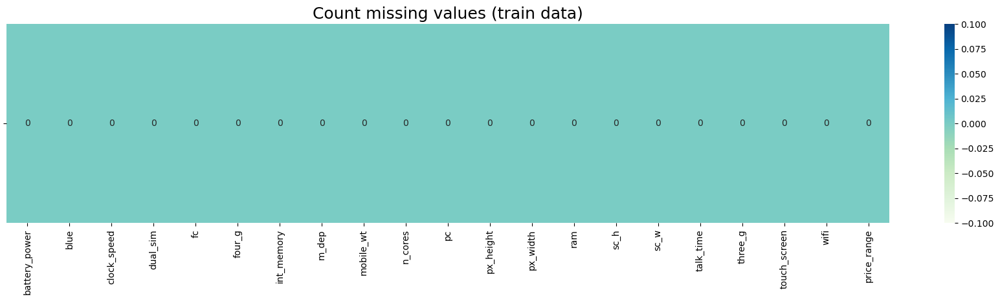

In [38]:
# Missing values (train)
plt.figure(figsize=(22,4))
sns.heatmap((Df.isna().sum()).to_frame(name='').T,cmap='GnBu', annot=True,
             fmt='0.0f').set_title('Count missing values (train data)', fontsize=18)
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">

There aren't any **missing values** in the **train** dataset.

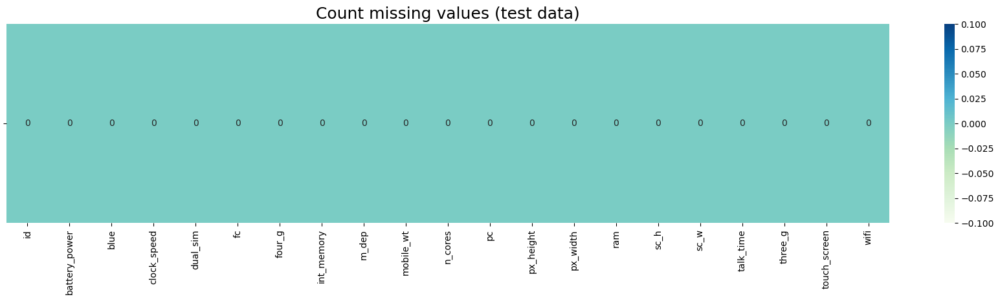

In [39]:
# Missing values (test)
plt.figure(figsize=(22,4))
sns.heatmap((Df_test.isna().sum()).to_frame(name='').T,cmap='GnBu', annot=True,
             fmt='0.0f').set_title('Count missing values (test data)', fontsize=18)
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">

There aren't any **missing values** in the **test** dataset.

<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">🎄Duplicated Data</p>

### 🟢Check for Duplicated data

In [40]:
# Duplicated data (train)
Df.duplicated().sum()

0

In [41]:
# Duplicated data (test)
Df_test.duplicated().sum()

0

<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">🎄Redundant Columns</p>

### 🟢Drop Redundant Columns

<div style="background-color:#d5eae9; padding:20px; font-size:15px">

We should drop any **redundant columns** from the dataset which does not have any predictive power. Here, **'Id'** is the redundant column in test data. So, we will drop it first.

In [42]:
# Drop Id column in test data
Df_test.drop(['id'], axis=1, inplace=True)
Df_test.shape

(1000, 20)

<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">🎄Outliers</p>

### 🟢Check for Outliers

In [43]:
# Separate numerical and categorical features
num_cols = pd.DataFrame (Df, columns= ['battery_power', 'clock_speed', 'fc', 'int_memory', 'm_dep', 'mobile_wt', 'pc', 'px_height', 'px_width', 'ram', 'sc_h', 'sc_w', 'talk_time'])
cat_cols = pd.DataFrame (Df, columns= ['blue', 'dual_sim', 'four_g', 'n_cores', 'three_g', 'touch_screen', 'wifi'])

In [44]:
# Separate numerical and categorical features into different lists
numerical_columns = list(Df.loc[:,['battery_power', 'clock_speed', 'fc', 'int_memory', 'm_dep', 'mobile_wt', 'pc', 'px_height', 'px_width', 'ram', 'sc_h', 'sc_w', 'talk_time']])
categorical_columns = list(Df.loc[:,['blue', 'dual_sim', 'four_g', 'n_cores', 'three_g', 'touch_screen', 'wifi']])

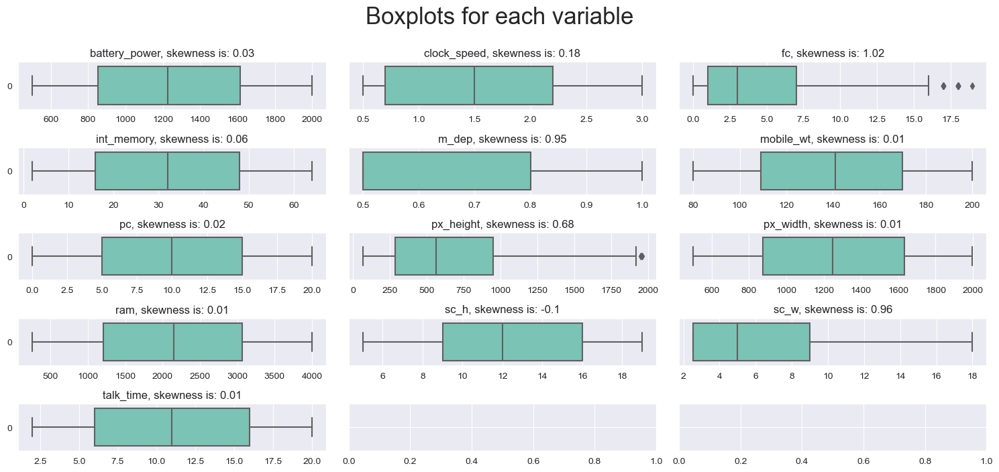

In [45]:
# Visualizing the Numerical Features by boxplots
sns.set_style('darkgrid')
def boxplots_custom(dataset, columns_list, rows, cols, suptitle):
    fig, axs = plt.subplots(rows, cols, sharey=True, figsize=(15,7))
    fig.suptitle(suptitle, y=1, size=25)
    axs = axs.flatten()
    for i, data in enumerate(columns_list):
        sns.boxplot(data=dataset[data], orient='h', color ='#6fcfbc', ax=axs[i])
        axs[i].set_title(data + ', skewness is: '+str(round(dataset[data].skew(axis = 0, skipna = True), 2)))
        
boxplots_custom(dataset=Df, columns_list=num_cols, rows=5, cols=3, suptitle='Boxplots for each variable')
plt.tight_layout()

### 🟢Detect Outliers

In [46]:
# Calculate the IQR for each column in the dataset
Q1 = num_cols.quantile(0.25)
Q3 = num_cols.quantile(0.75)
IQR = Q3 - Q1

# Identify outliers using the IQR method
outliers = ((num_cols < (Q1 - 1.5 * IQR)) | (num_cols > (Q3 + 1.5 * IQR)))

# Count the number of outliers for each variable
num_outliers = outliers.sum()

# Number of outliers for each variable
num_outliers.to_frame().T

,battery_power,clock_speed,fc,int_memory,m_dep,mobile_wt,pc,px_height,px_width,ram,sc_h,sc_w,talk_time
0,0,0,18,0,0,0,0,2,0,0,0,0,0


<div style="background-color:#e9f5f0; padding:20px; font-size:15px">

- While the boxplots in the table above indicate the presence of outliers in the **fc** and **px_height** features, we cannot justify removing them from the dataset without a strong rationale to do so. Therefore, we have decided to retain these outliers in our analysis.

<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">🎄Noises</p>

### 🟢Check for Noises

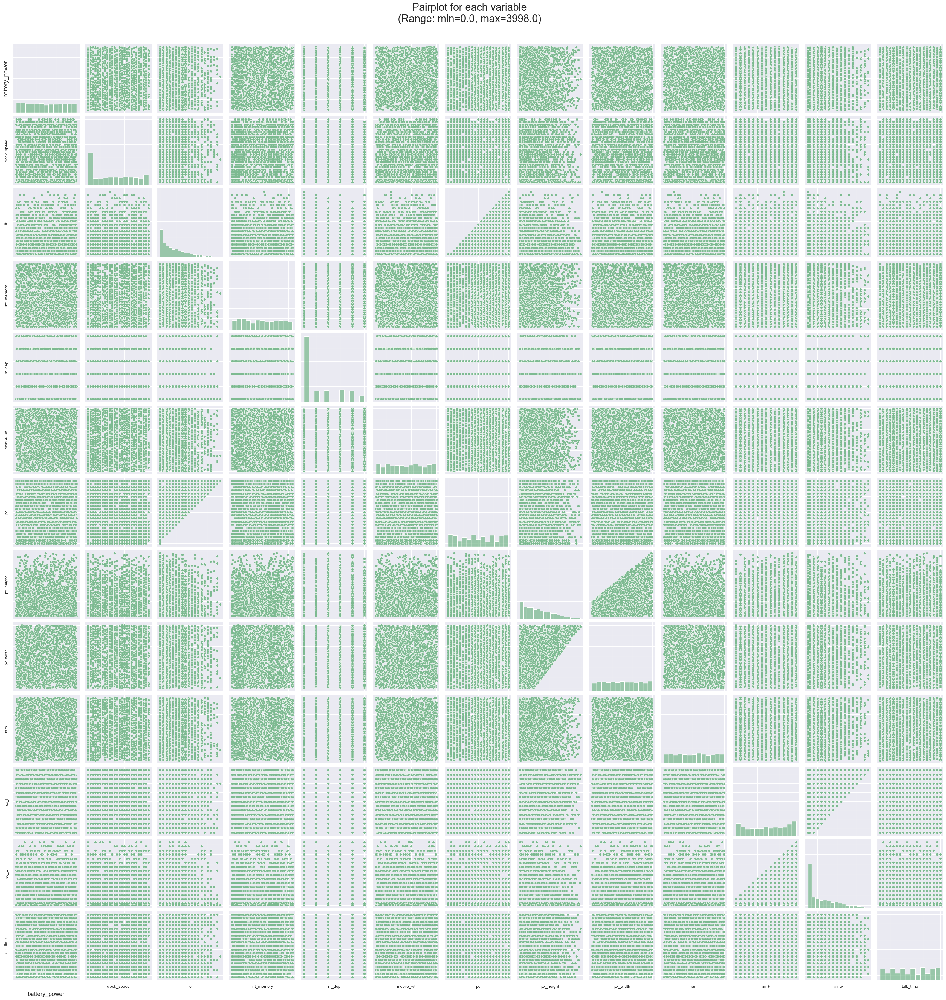

In [47]:
# Check noises by pairplot
sns.set_palette('crest')
sns.set_style('darkgrid')
dnp = sns.pairplot(Df.loc[:, numerical_columns])

# Add axis labels and tick labels to the plot
dnp.set(xticklabels=[], yticklabels=[])
dnp.axes[0][0].set_ylabel(numerical_columns[0], fontsize=14)
dnp.axes[-1][0].set_xlabel(numerical_columns[0], fontsize=14)
dnp.axes[-1][0].xaxis.labelpad = 20
dnp.axes[-1][-1].yaxis.labelpad = 20

# Title of the plot
dnp.fig.suptitle('Pairplot for each variable\n(Range: min={}, max={})'.format(Df[numerical_columns].min().min(), Df[numerical_columns].max().max()), y=1.03, fontsize=25)

# Show the plot
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">

- It seems that there isn't any **Noisy** data in the train dataset.

<a id="1"></a>  
# <p style="padding:10px;background-color:#254441;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 15px 50px;overflow:hidden;font-weight:500">5. Exploratory Data Analysis (EDA)</p>

<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">5.1. Continuos and Categorical Data Distribution</p>

Total number of features except for the target: 20
Number of categorical (<25 Unique Values) features: 13
Number of continuous features: 7


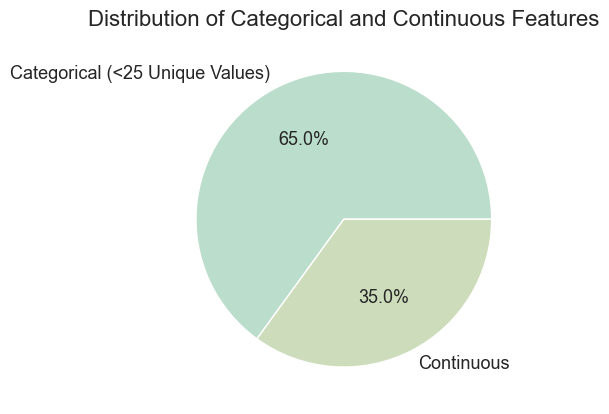

In [48]:
TARGET = 'price_range'
FEATURES = [col for col in Df.columns if col not in ['Df', TARGET]]

cat_features = [col for col in FEATURES if Df[col].nunique() < 25]
cont_features = [col for col in FEATURES if Df[col].nunique() >= 25]

num_cat_features = len(cat_features)
num_cont_features = len(cont_features)

print(f"Total number of features except for the target: {len(FEATURES)}")
print(f"\033[92mNumber of categorical (<25 Unique Values) features: {num_cat_features}")
print(f"\033[96mNumber of continuous features: {num_cont_features}")

# Define labels and colors for the pie chart
labels = ['Categorical (<25 Unique Values)', 'Continuous']
colors = ['#bbddcb', '#cdddbb']

plt.pie([num_cat_features, num_cont_features], 
        labels=labels,
        colors=colors,
        textprops={'fontsize': 13},
        autopct='%1.1f%%')

# Add a title to the plot
plt.title('Distribution of Categorical and Continuous Features', fontsize=16)

# Show the plot
plt.show()

<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">5.2. Data Imbalance</p>

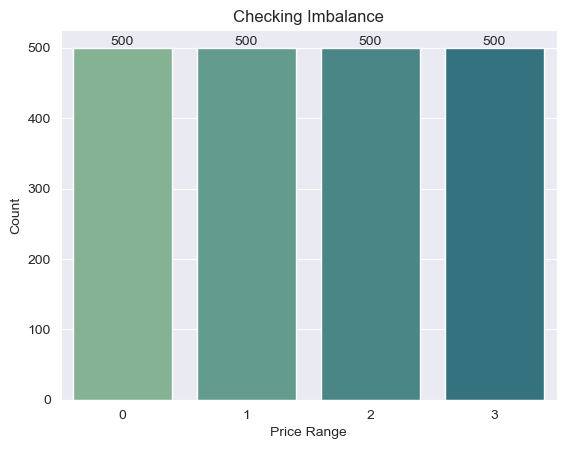

In [49]:
# Create a count plot of the 'price_range' column and label the bars with their counts
ax = sns.countplot(Df["price_range"])
for container in ax.containers:
    ax.bar_label(container)

# Set the x-axis and y-axis labels
plt.xlabel("Price Range")
plt.ylabel("Count")

# Set the title of the plot
plt.title("Checking Imbalance")

# Show the plot
plt.show()

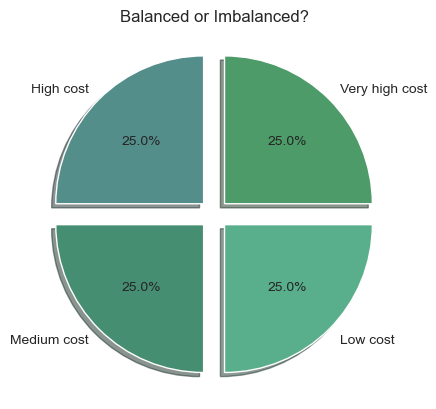

In [50]:
# Count the number of occurrences of each value in the 'price_range' column
value_counts = pd.value_counts(Df['price_range'])

# Define the label strings using f-strings
label = [f'{"Very high" if i==0 else "High" if i==1 else "Medium" if i==2 else "Low"} cost' for i in range(len(value_counts))]

# Define the colors for each pie slice
colors = ['#4d9b68', '#538e8a', '#468e71', '#59ae8c']

# Create a pie chart with percentage values formatted with a % sign and explode the slices
fig, ax = plt.subplots()
ax.pie(value_counts.values, autopct='%0.1f%%', explode=[0.1, 0.1, 0.1, 0.1], shadow=True, labels=label, colors=colors)

# Set the title of the pie chart
ax.set_title('Balanced or Imbalanced?')

# Show the pie chart
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">

- The above charts show that all classes of the target variable have the **same count**. So, the target data is **completely balanced**.

<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">5.3. Univariate Analysis</p>

<h4 align="left"><font color='#254441'>5.3.1. Exploring Categorical Features</font>

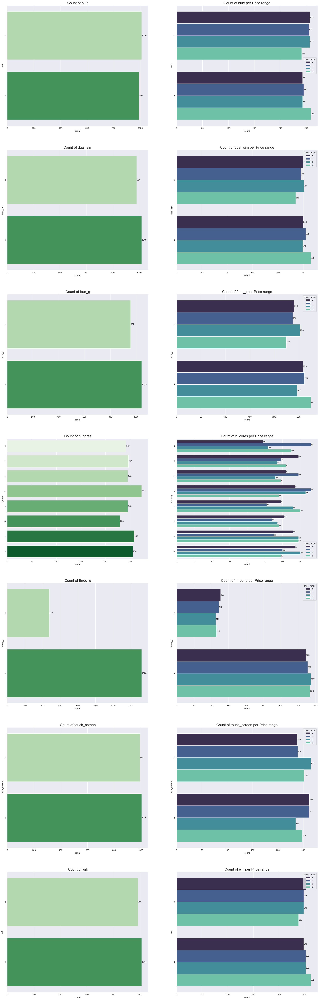

In [51]:
fig, axes = plt.subplots(7,2, figsize=(25,80))
sns.set_style('darkgrid')
idx = 0
for col in categorical_columns:
    sns.countplot(data=Df, y=col, palette='Greens', orient='h',
                  ax=axes[idx][0]).set_title(f'Count of {col}', fontsize='16')
    for container in axes[idx][0].containers:
        axes[idx][0].bar_label(container)
    sns.countplot(data=Df, y=col, palette='mako', orient='h',  hue='price_range',
                  ax=axes[idx][1]).set_title(f'Count of {col} per Price range', fontsize='16')
    for container in axes[idx][1].containers:
        axes[idx][1].bar_label(container)
    idx +=1
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
    <strong>Observations:</strong> 
    <br>
    
- **Bluetooth:**    
  - The count of the **blue** chart shows that mobile phones **without Bluetooth** have the highest frequency than the ones with Bluetooth.
  - Moreover, the count of **blue** per price range shows that in the group of mobile phones **without Bluetooth**, the **Low-cost** and **High-cost** phones have the highest frequency, and on the other hand, in the group of mobile phones **with Bluetooth**, the **Very high-cost** phones have the highest frequency.
    
- **Dual Sim:**     
  - The count of the **dual_sim** chart shows that mobile phones which **have Dual Sim** have the highest frequency.
  - Moreover, the count of **dual_sim** per price range shows that in the group of mobile phones **without Dual Sim**, the **High-cost** and **Low-cost** phones have the highest frequency, and in the group of mobile phones **with Dual Sim**, the **Very high-cost** phones have the highest frequency.
    
- **4G:**     
  - The count of the **four_g** chart shows that mobile phones which **have 4G** have the highest frequency than the ones without 4G.
  - Moreover, the count of **four_g** per price range shows that in the group of mobile phones **with 4G**, the **Medium-cost** phones have the highest frequency.    
    
- **Number of Cores:**     
  - The count of the **n-cores** chart shows that mobile phones **containing 4 cores** have the highest frequency.
  - Moreover, the count of **n-cores** per price range shows that in the group of mobile phones **with 4 cores**, the **High-cost** phones have the highest frequency, and in the group of mobile phones **containing 4 cores**, the **Medium-cost** phones have the highest frequency.  
    
- **3G:**     
  - The count of the **three_g** chart shows that mobile phones **with 3G** have the highest frequency than the ones without 3G.
  - Moreover, the count of **three_g** per price range shows that in the group of mobile phones **with 3G**, the **High-cost** phones have the highest frequency, and in the group of mobile phones **without 3G**, the **Low-cost** phones have the highest frequency.
    
- **Touch Screen:**     
  - The count of the **touch_screen** chart shows that mobile phones which **have Touch Screen** have the highest frequency than the ones without Touch Screen.
  - Moreover, the count of **touch_screen** per price range shows that in the group of mobile phones **with Touch Screen**, the **Low-cost** phones have the highest frequency, and in the group of mobile phones **without Touch Screen**, the **High-cost** phones have the highest frequency.
    
- **Wifi:**     
  - The count of the **wifi** chart shows that mobile phones which **have Wifi** have the highest frequency than the ones without Wifi.
  - Moreover, the count of **wifi** per price range shows that in the group of mobile phones **with Wifi**, the **Very high-cost** phones have the highest frequency, and in the group of mobile phones **without Wifi**, the **Low-cost** phones have the highest frequency.

In [52]:
from IPython.core.display import HTML

def multi_table(table_list):
    ''' Acceps a list of IpyTable objects and returns a table which contains each IpyTable in a cell
    '''
    return HTML(
        '<table><tr style="background-color:white;">' + 
        ''.join(['<td>' + table._repr_html_() + '</td>' for table in table_list]) +
        '</tr></table>')

In [53]:
print("An overview of percentages of each unique value in different categorical features:")
Df_nunique = {var: pd.DataFrame((Df[var].value_counts()/len(Df[var])*100).map('{:.2f}%'.format)) 
              for var in {'blue', 'dual_sim', 'four_g', 'n_cores', 'three_g', 'touch_screen', 'wifi'}}
multi_table([Df_nunique['blue'], Df_nunique['dual_sim'],Df_nunique['four_g'],Df_nunique['n_cores'],Df_nunique['three_g'],Df_nunique['touch_screen'],Df_nunique['wifi']])

An overview of percentages of each unique value in different categorical features:


,blue
0,50.50%
1,49.50%
,dual_sim
1,50.95%
0,49.05%
,four_g
1,52.15%
0,47.85%
,n_cores
4,13.70%


In [54]:
# Describing the categorical variables
cat_cols.describe().style.background_gradient(cmap=cmap)

,blue,dual_sim,four_g,n_cores,three_g,touch_screen,wifi
count,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,0.495000,0.509500,0.521500,4.520500,0.761500,0.503000,0.507000
std,0.500100,0.500035,0.499662,2.287837,0.426273,0.500116,0.500076
min,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,3.000000,1.000000,0.000000,0.000000
50%,0.000000,1.000000,1.000000,4.000000,1.000000,1.000000,1.000000
75%,1.000000,1.000000,1.000000,7.000000,1.000000,1.000000,1.000000
max,1.000000,1.000000,1.000000,8.000000,1.000000,1.000000,1.000000


<h4 align="left"><font color='#254441'>5.3.2. Exploring Numerical Features</font>

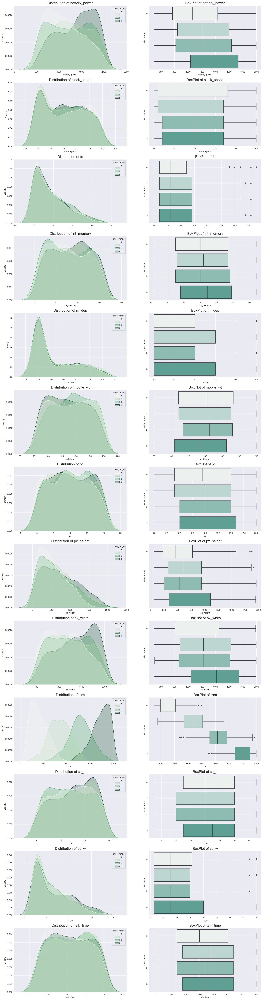

In [55]:
fig, axes = plt.subplots(13,2, figsize=(20,80))
sns.set_style('darkgrid')
idx = 0
for col in (numerical_columns):
    sns.kdeplot(data=Df, x=col, palette='Greens',fill=True , hue='price_range', 
                ax=axes[idx][0]).set_title(f'Distribution of {col}', fontsize='16')
    sns.boxplot(data=Df, x=col, palette='light:#5A9' , y='price_range', orient='h', 
                ax=axes[idx][1]).set_title(f'BoxPlot of {col}', fontsize='16')
    idx +=1
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
    <strong>Observations:</strong> 
    <br>
    
- A **normal distribution (with no skewness)** is observed in the features of **int_memory**, **mobile_wt**, **pc** and **talk time** for all price ranges.
    
- **Battery Power**:    
  - Mobile phones with price ranges of 0-3 mostly have **battery_power** at the range of **600-800, 700-1350, 600-900**, and **1500-1900 mAh**, respectively.
    
- **Clock Speed**: 
  - Mobile phones with all price ranges mostly have **clock_speed** at the range of **0.4-0.8**.
  - A **positive skewness** is observed in the distribution of **clock_speed** for all price ranges.
  - The box plot of **clock_speed** indicates that all price ranges have the same **median** equal **1.5**.
    
- **Front Camera**:
  - Mobile phones with all price ranges mostly have **fc** in the range of **0-2.5 megapixels**.
  - A **positive skewness** is observed in the distribution of **fc** for all price ranges.
  - The box plot of **fc** indicates that all price ranges have the same **median** equal **3 megapixels**.
    
- **Internal Memory**:    
  - Mobile phones with price ranges of 0-3 mostly have **int_memory** at the range of **10-30, 35-50, 13-20**, and **40-50 gigabytes**, respectively.
 
- **Mobile Depth**: 
  - A **positive skewness** is observed in the distribution of **m_dep** for all price ranges.
  - Mobile phones with all price ranges mostly have **m_dep** at the range of **0.5-0.55 cm**.
    
- **Pixel Resolution Height**:     
  - A **positive skewness** is observed in the distribution of **px_height** for all price ranges.
  - Mobile phones with all price ranges mostly have **px_height** in the range of **65-500 pixels**.
    
- **Pixel Resolution Width**:
  - Mobile phones with price ranges of 0-3 mostly have **px_width** in the range of **750-900, 700-1350, 750-1200**, and **1500-1700 pixels**, respectively.
    
- **Ram**:
  - Mobile phones with price ranges of 0-3 mostly have **ram** at the range of **450-750, 1350-1900, 2500-2800**, and **3500-3950 megabytes**, respectively.
    
- **Screen Width**:
  - A **positive skewness** is observed in the distribution of **sc_w** for all price ranges.
  - Mobile phones with all price ranges mostly have **sc_w** in the range of **2.5-4 cm**.
  - The box plot of **sc_w** indicates that all price ranges have the same **median** equal **1.5 cm**.

In [56]:
pr = Df.groupby(['price_range'])
target = pr.describe(percentiles = [0.25, 0.5, 0.75])[numerical_columns]
target.T.style.background_gradient(cmap='Greens')

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
   <strong>Observations:</strong> 
    <br>
    
- The highest **mean** value of **battery_power**, **int_memory**, **pc**, **px_height**, **px_width**, **ram**, **sc_h** and **sc_w** belong to the **Very high-cost** mobile phones.

<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">5.4. Bivariate Analysis</p>

#### 🎄Clock speed:

In [57]:
Df.clock_speed.describe()

count    2000.000000
mean        1.522250
std         0.816004
min         0.500000
25%         0.700000
50%         1.500000
75%         2.200000
max         3.000000
Name: clock_speed, dtype: float64

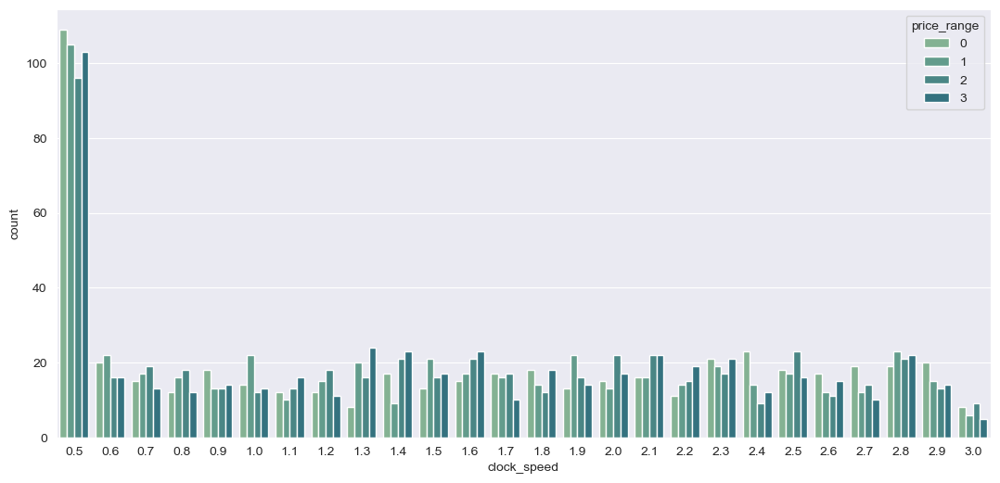

In [58]:
# clock_speed based on price_range
plt.figure(figsize = (13,6))
sns.countplot(x = Df['clock_speed'], hue ="price_range", data=Df) 
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
    <strong>Observations:</strong> 
    <br>

- The above chart illustrates that the phones with a **clock_speed** of **0.5** contains the highest count among all mobile phones.

#### 🎄Front Camera (Megapixels):

In [59]:
Df.fc.describe()

count    2000.000000
mean        4.309500
std         4.341444
min         0.000000
25%         1.000000
50%         3.000000
75%         7.000000
max        19.000000
Name: fc, dtype: float64

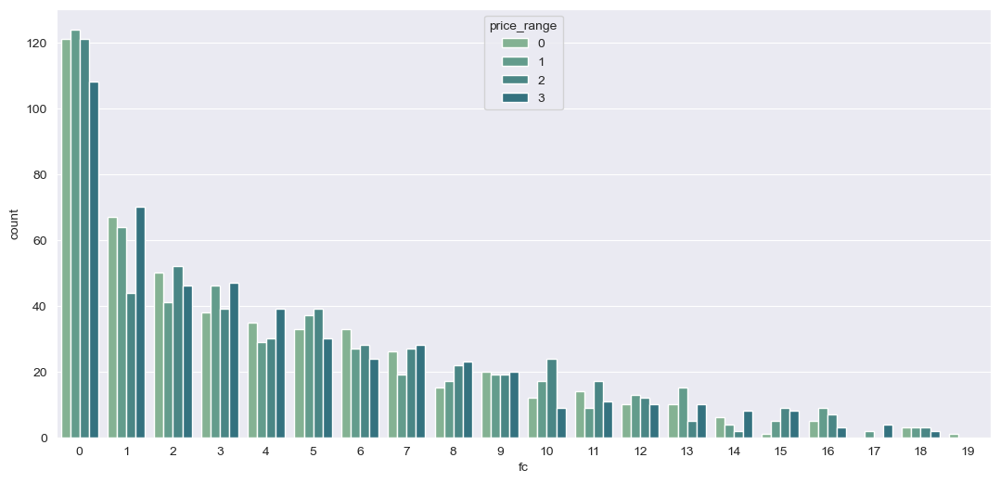

In [60]:
# fc based on price_range
plt.figure(figsize = (13,6))
sns.countplot(x = Df['fc'], hue ="price_range", data=Df) 
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
        <strong>Observations:</strong> 
    <br>

- The above chart illustrates that with the increase in the value of **fc** from 0-19, their count will decrease. This indicates that as the **front camera** becomes more powerful, the number of phones decreases.

#### 🎄Internal Memory (Gigabytes):

In [61]:
Df.int_memory.describe()

count    2000.000000
mean       32.046500
std        18.145715
min         2.000000
25%        16.000000
50%        32.000000
75%        48.000000
max        64.000000
Name: int_memory, dtype: float64

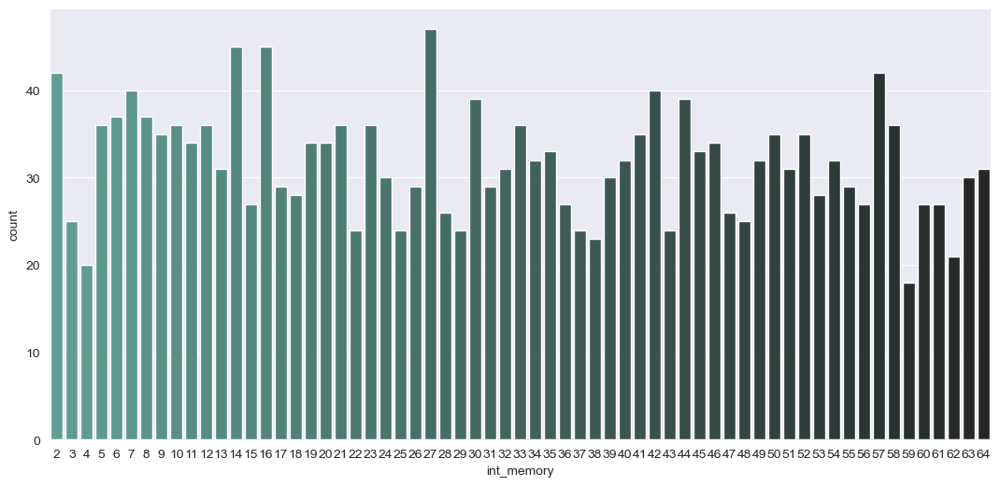

In [62]:
# count of int_memory
plt.figure(figsize = (13,6))
sns.countplot(x = Df['int_memory'], palette='dark:#5A9_r', data=Df) 
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
    <strong>Observations:</strong> 
    <br>
    
- Mobile phones with **27 gigabytes** of **int_memory** with the value of **64** have the highest count among all phones.

#### 🎄Mobile Depth (Cm):

In [63]:
Df.m_dep.describe()

count    2000.000000
mean        0.626000
std         0.165159
min         0.500000
25%         0.500000
50%         0.500000
75%         0.800000
max         1.000000
Name: m_dep, dtype: float64

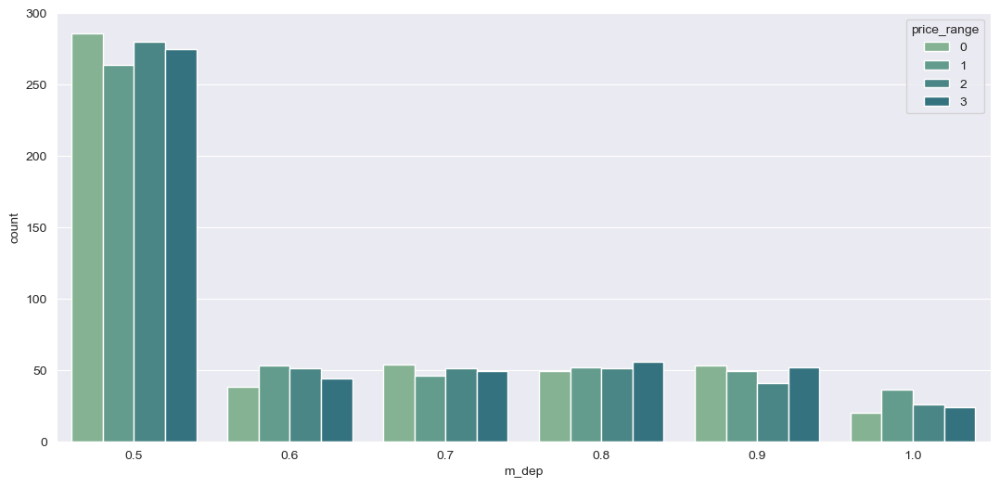

In [64]:
# m_dep based on price_range
plt.figure(figsize = (13,6))
sns.countplot(x = Df['m_dep'], hue ="price_range", data=Df) 
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
        <strong>Observations:</strong> 
    <br>
    
- Mobile phones with **0.5 cm** of **m_dep** have the highest count among all phones.

#### 🎄Primary Camera (Megapixels):

In [65]:
Df.pc.describe()

count    2000.000000
mean        9.916500
std         6.064315
min         0.000000
25%         5.000000
50%        10.000000
75%        15.000000
max        20.000000
Name: pc, dtype: float64

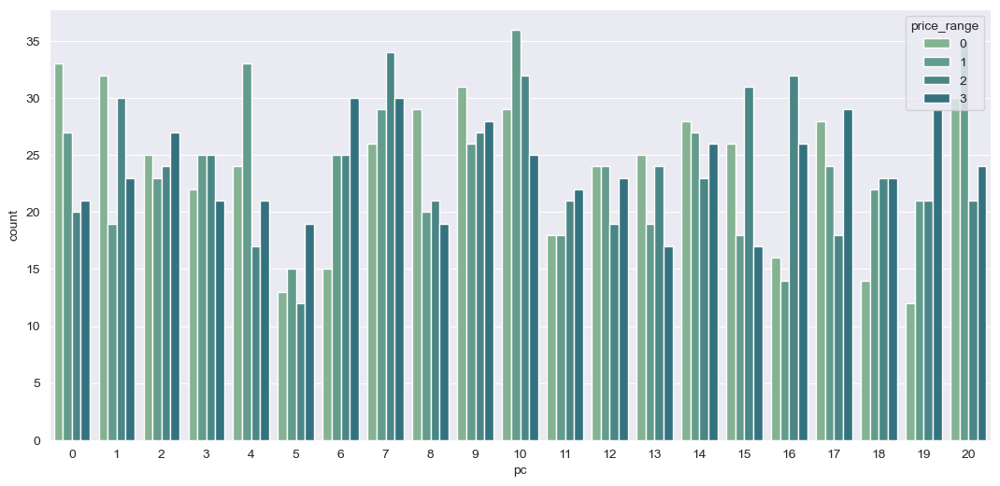

In [66]:
# pc based on price_range
plt.figure(figsize = (13,6))
sns.countplot(x = Df['pc'], hue ="price_range", data=Df) 
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
        <strong>Observations:</strong> 
    <br>

- In general, mobile phones with **5 Megapixels** of **pc** have the lowest count among all phones.

#### 🎄Screen Height (Cm):

In [67]:
Df.sc_h.describe()

count    2000.000000
mean       12.306500
std         4.213245
min         5.000000
25%         9.000000
50%        12.000000
75%        16.000000
max        19.000000
Name: sc_h, dtype: float64

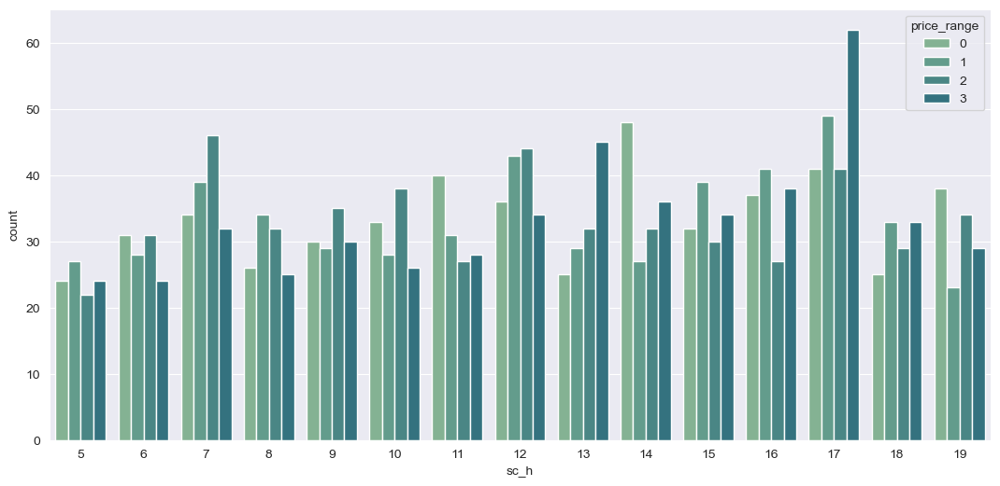

In [68]:
# sc_h based on price_range
plt.figure(figsize = (13,6))
sns.countplot(x = Df['sc_h'], hue ="price_range", data=Df) 
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
        <strong>Observations:</strong> 
    <br>
    
- In general, mobile phones with **17 Cm** of **sc_h** have the highest count among all phones.

#### 🎄Screen Width (Cm):

In [69]:
Df.sc_w.describe()

count    2000.000000
mean        6.199420
std         3.891793
min         2.540000
25%         2.540000
50%         5.000000
75%         9.000000
max        18.000000
Name: sc_w, dtype: float64

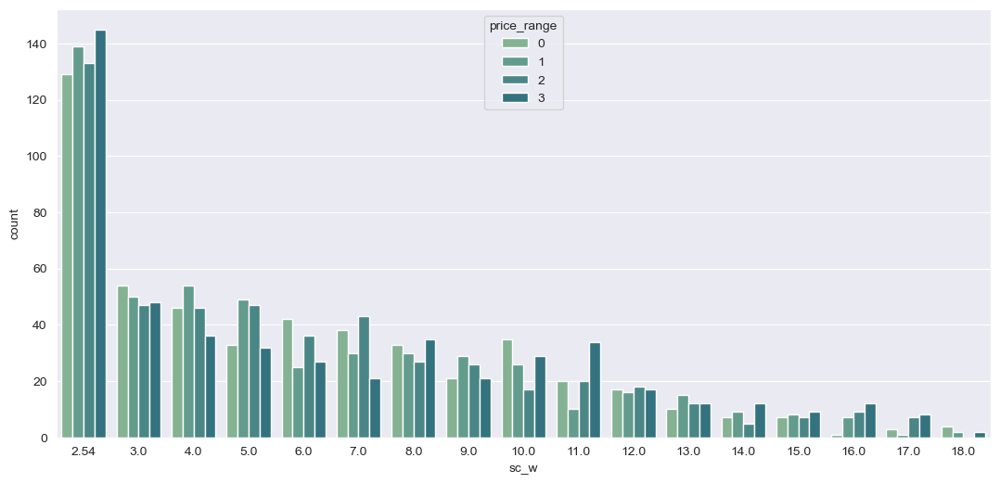

In [70]:
# sc_w based on price_range
plt.figure(figsize = (13,6))
sns.countplot(x = Df['sc_w'], hue ="price_range", data=Df) 
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
    <strong>Observations:</strong> 
    <br>

- The above chart demonstrates that with the increase in the value of **sc_w** from **2.54-18**, their count will decrease. This indicates that as the **Screen Width** becomes bigger, the number of phones decreases.
- In general, mobile phones with **2.54 cm or 1-inch** of **sc_w** have the highest count among all phones.

#### 🎄Talk Time:

In [71]:
Df.talk_time.describe()

count    2000.000000
mean       11.011000
std         5.463955
min         2.000000
25%         6.000000
50%        11.000000
75%        16.000000
max        20.000000
Name: talk_time, dtype: float64

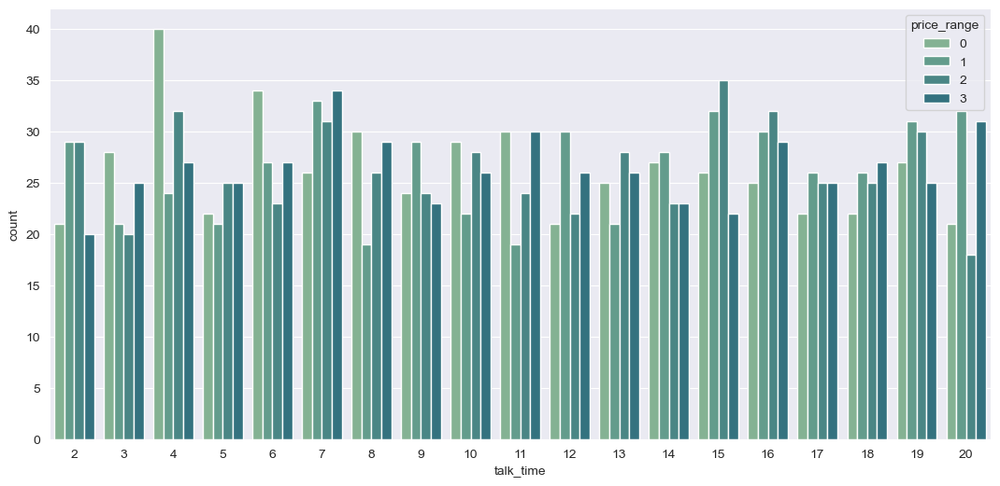

In [72]:
# talk_time based on price_range
plt.figure(figsize = (13,6))
sns.countplot(x = Df['talk_time'], hue ="price_range", data=Df) 
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
        <strong>Observations:</strong> 
    <br>
    
- The range of **talk_time** varies from **2 to 20**.
- Mobile phones with **talk_time 4** with a **Low-cost price range** have the highest count among all phones.

#### 🎄Ram (Megabytes):

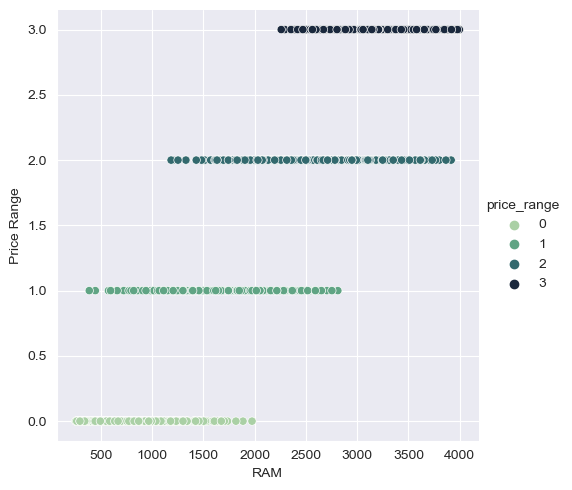

In [73]:
# Create scatter plot
sns.relplot(data=Df, x="ram", y="price_range", hue="price_range", palette="ch:r=-.5, l=.75")

# Add axis labels
plt.xlabel("RAM", fontsize=10)
plt.ylabel("Price Range", fontsize=10)

# Show the plot
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
    <strong>Observations:</strong> 
    <br>
    
- By increasing the value of ram from **256-4000 megabytes**, the price range will increase.

#### 🎄Mean of 'Price range' per each unique value of different categorical features:

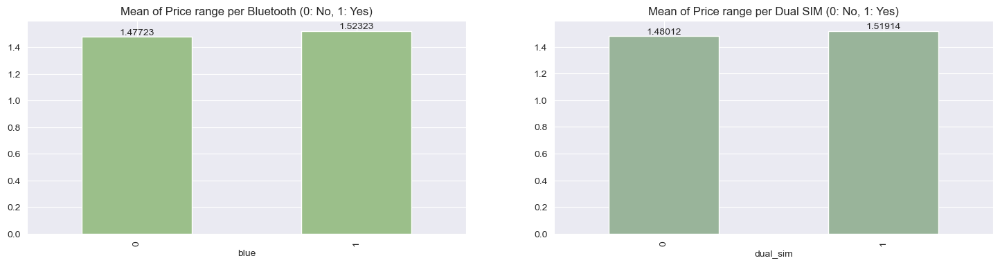

In [74]:
f,ax=plt.subplots(1,2,figsize=(18, 4))

ax1= Df[['price_range','blue']].groupby(['blue']).mean().plot.bar(color='#9bbf8a',ax=ax[0])
for container in ax1.containers:
    ax1.bar_label(container)
ax[0].set_title('Mean of Price range per Bluetooth (0: No, 1: Yes)')
ax1.legend().set_visible(False)

ax2= Df[['price_range','dual_sim']].groupby(['dual_sim']).mean().plot.bar(color='#99b49a',ax=ax[1])  
for container in ax2.containers:
    ax2.bar_label(container)
ax[1].set_title('Mean of Price range per Dual SIM (0: No, 1: Yes)')
ax2.legend().set_visible(False)

plt.show()

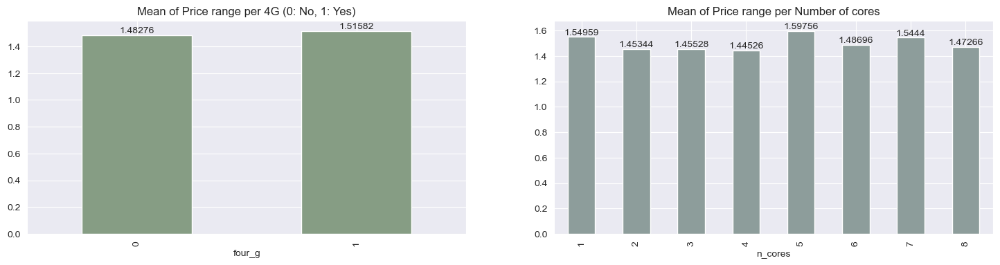

In [75]:
f,ax=plt.subplots(1,2,figsize=(18, 4))

ax1= Df[['price_range','four_g']].groupby(['four_g']).mean().plot.bar(color='#869d84',ax=ax[0])
for container in ax1.containers:
    ax1.bar_label(container)
ax[0].set_title('Mean of Price range per 4G (0: No, 1: Yes)')
ax1.legend().set_visible(False)

ax2= Df[['price_range','n_cores']].groupby(['n_cores']).mean().plot.bar(color='#8d9d9b',ax=ax[1])  
for container in ax2.containers:
    ax2.bar_label(container)
ax[1].set_title('Mean of Price range per Number of cores')
ax2.legend().set_visible(False)

plt.show()

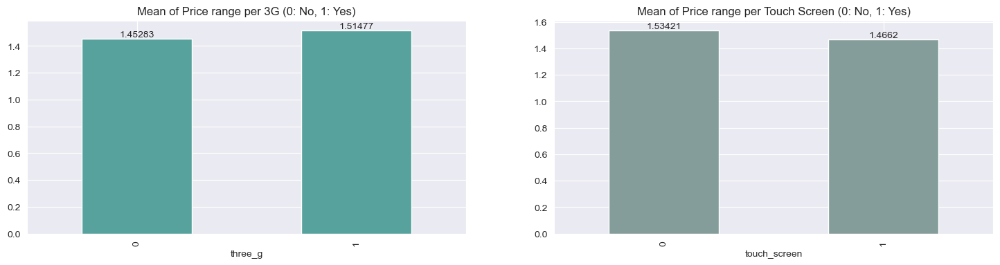

In [76]:
f,ax=plt.subplots(1,2,figsize=(18, 4))

ax1= Df[['price_range','three_g']].groupby(['three_g']).mean().plot.bar(color='#58a29d',ax=ax[0])
for container in ax1.containers:
    ax1.bar_label(container)
ax[0].set_title('Mean of Price range per 3G (0: No, 1: Yes)')
ax1.legend().set_visible(False)

ax2= Df[['price_range','touch_screen']].groupby(['touch_screen']).mean().plot.bar(color='#849d9b',ax=ax[1])  
for container in ax2.containers:
    ax2.bar_label(container)
ax[1].set_title('Mean of Price range per Touch Screen (0: No, 1: Yes)')
ax2.legend().set_visible(False)

plt.show()

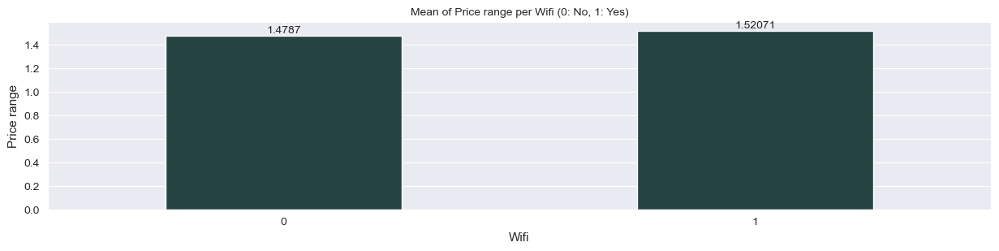

In [77]:
plt.figure(figsize = (15, 3))
a=Df.groupby('wifi')['price_range'].mean()
ax = a.plot.bar(color="#254441", width=.5)
for container in ax.containers:
    ax.bar_label(container)
plt.title('Mean of Price range per Wifi (0: No, 1: Yes)', size=10)
plt.ylabel('Price range', size=11)
plt.xlabel('Wifi', size=11)
plt.xticks(rotation=0)
plt.legend().set_visible(False)
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
  <strong>Observations:</strong> 
    <br>
    
- The Mean of Price range per Number of cores shows that mobile phones with **5 cores** have the highest mean of the price range.

In [78]:
# Describing the numerical variables
num_cols.describe().style.background_gradient(cmap='Greens')

,battery_power,clock_speed,fc,int_memory,m_dep,mobile_wt,pc,px_height,px_width,ram,sc_h,sc_w,talk_time
count,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000,2000.000000
mean,1238.518500,1.522250,4.309500,32.046500,0.626000,140.249000,9.916500,646.529000,1251.515500,2124.213000,12.306500,6.199420,11.011000
std,439.418206,0.816004,4.341444,18.145715,0.165159,35.399655,6.064315,441.845917,432.199447,1084.732044,4.213245,3.891793,5.463955
min,501.000000,0.500000,0.000000,2.000000,0.500000,80.000000,0.000000,65.000000,500.000000,256.000000,5.000000,2.540000,2.000000
25%,851.750000,0.700000,1.000000,16.000000,0.500000,109.000000,5.000000,282.750000,874.750000,1207.500000,9.000000,2.540000,6.000000
50%,1226.000000,1.500000,3.000000,32.000000,0.500000,141.000000,10.000000,564.000000,1247.000000,2146.500000,12.000000,5.000000,11.000000
75%,1615.250000,2.200000,7.000000,48.000000,0.800000,170.000000,15.000000,947.250000,1633.000000,3064.500000,16.000000,9.000000,16.000000
max,1998.000000,3.000000,19.000000,64.000000,1.000000,200.000000,20.000000,1960.000000,1998.000000,3998.000000,19.000000,18.000000,20.000000


<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">5.5. Multivariate Analysis</p>

#### 🎄Internal memory - Ram:

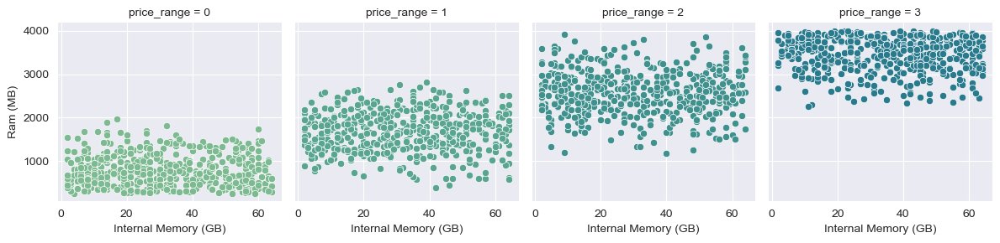

In [79]:
g = sns.FacetGrid(Df, col="price_range", hue="price_range")
g.map(sns.scatterplot, "int_memory", "ram")
g.set_axis_labels("Internal Memory (GB)", "Ram (MB)")
plt.show()

#### 🎄Ram - Battery power:

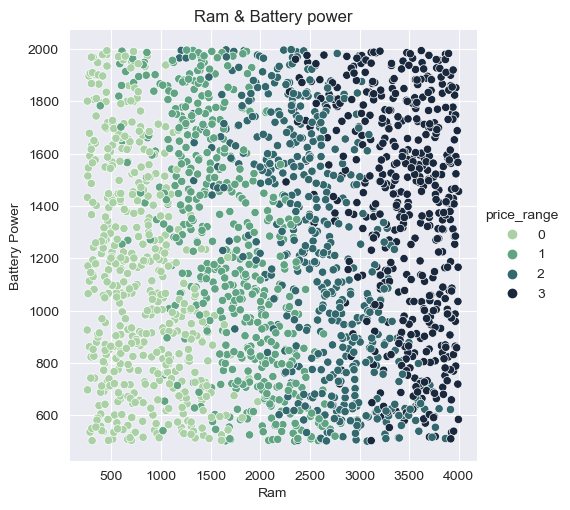

In [80]:
sns.relplot(data=Df, x="ram", y="battery_power", hue="price_range", palette="ch:r=-.5,l=.75")
plt.xlabel('Ram')
plt.ylabel('Battery Power')
plt.title('Ram & Battery power')
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
     <strong>Observations:</strong> 
    <br>
    
- Battery power does not necessarily improve by increasing the Ram of the mobile phones.

#### 🎄Display Resolution (Pixel Height x Pixel Width):

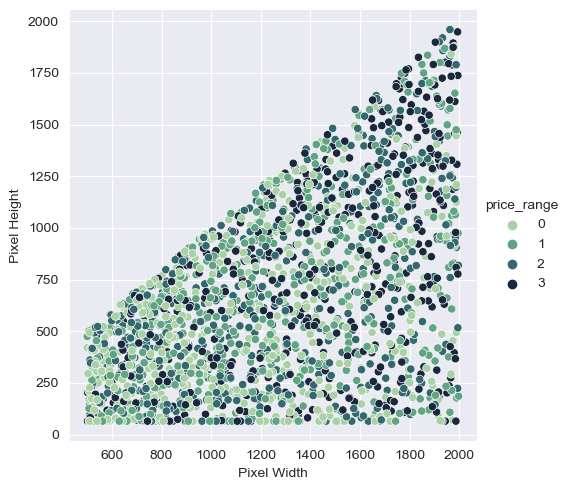

In [81]:
sns.relplot(data=Df, x="px_width", y="px_height", hue="price_range", palette="ch:r=-.5,l=.75")
plt.xlabel('Pixel Width')
plt.ylabel('Pixel Height')
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
   <strong>Observations:</strong> 
    <br>
    
- Generally, **Display Resolution** illustrates by increasing **Pixel Height**, the **Pixel Width** will increase. 

#### 🎄Screen Size (Screen Height x Screen Width):

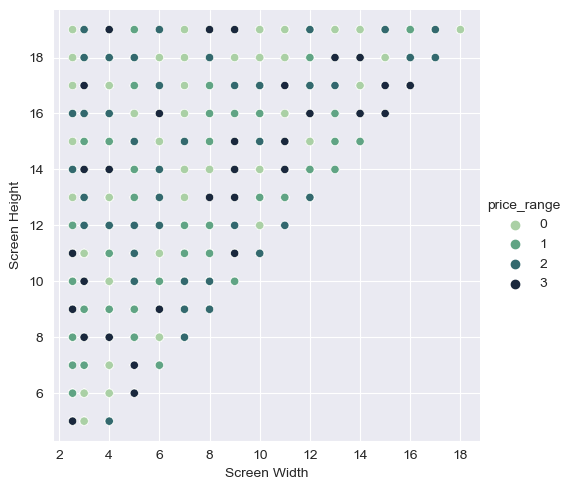

In [82]:
sns.relplot(data=Df, x="sc_w", y="sc_h", hue="price_range", palette="ch:r=-.5,l=.75")
plt.xlabel('Screen Width')
plt.ylabel('Screen Height')
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
    <strong>Observations:</strong> 
    <br>
    
- **Screen Size** illustrates by increasing **Screen Height**, the **Screen Width** will increase.

#### 🎄Bluetooth - Ram :

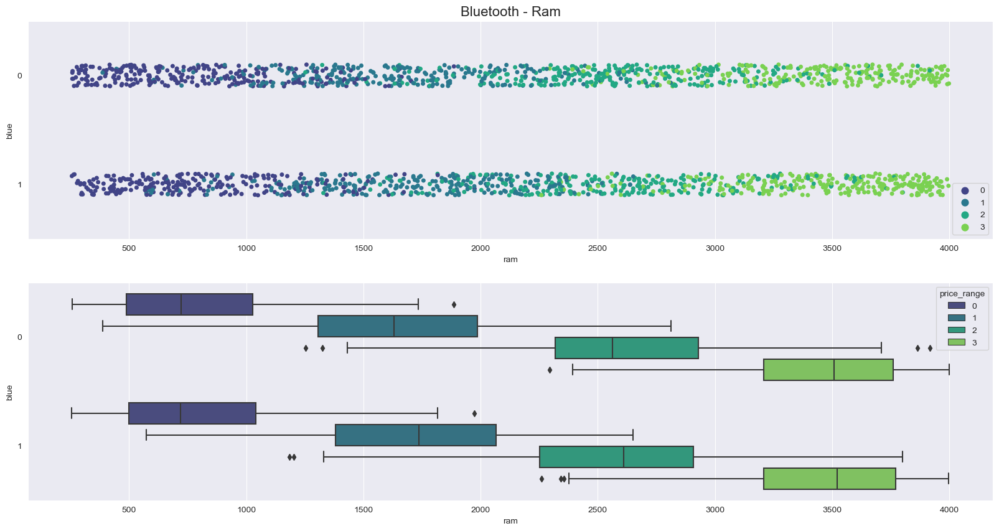

In [83]:
fig, axes = plt.subplots(2,1, figsize=(20,10))
sns.stripplot(data=Df, x='ram', palette='viridis', hue='price_range', y='blue', orient='h', ax=axes[0])
axes[0].set_title('Bluetooth - Ram', fontsize='16')
axes[0].legend(loc=4)
sns.boxplot(data=Df, x='ram', palette='viridis', hue='price_range', y='blue', orient='h', ax=axes[1])
plt.show()

#### 🎄Dual Sim - Ram:

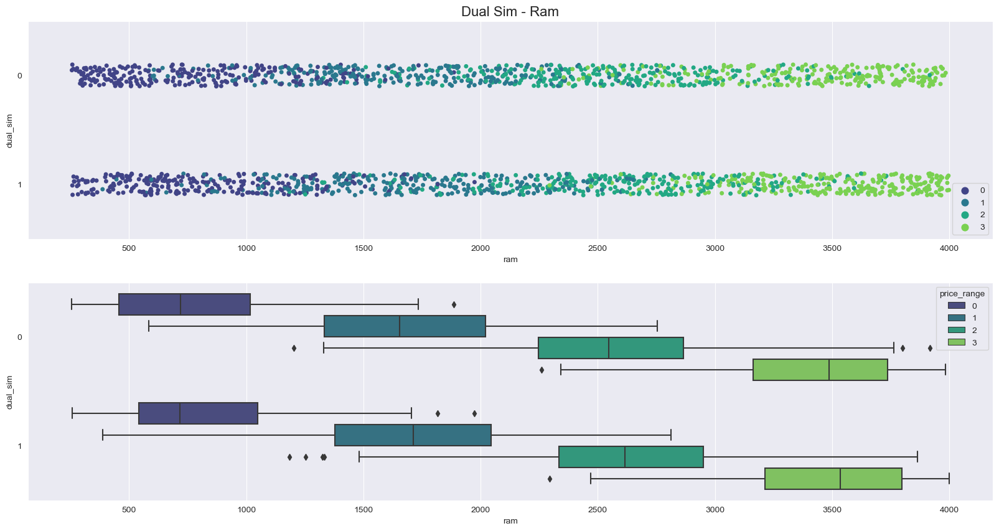

In [84]:
fig, axes = plt.subplots(2,1, figsize=(20,10))
sns.stripplot(data=Df, x='ram', palette='viridis', hue='price_range', y='dual_sim', orient='h', ax=axes[0])
axes[0].set_title('Dual Sim - Ram', fontsize='16')
axes[0].legend(loc=4)
sns.boxplot(data=Df, x='ram', palette='viridis', hue='price_range', y='dual_sim', orient='h', ax=axes[1])
plt.show()

#### 🎄4G - Ram:

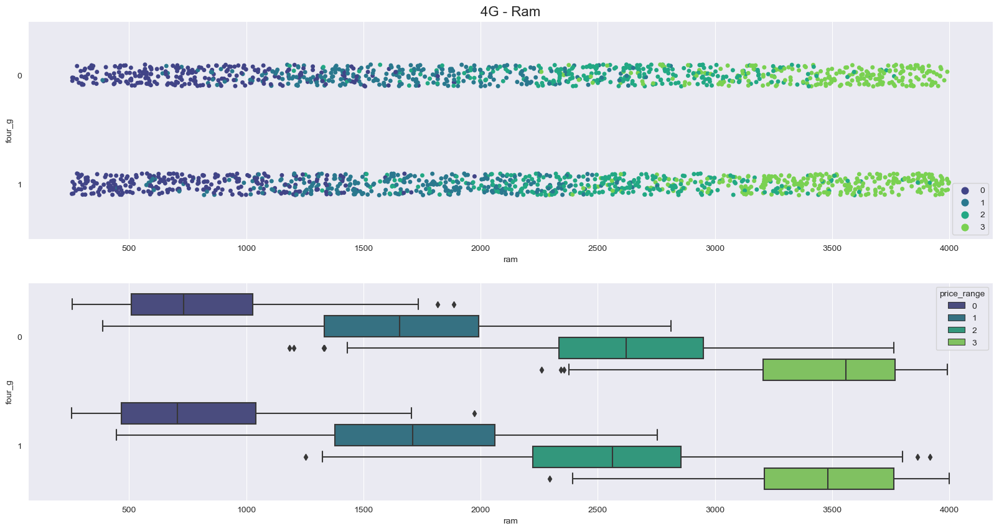

In [85]:
fig, axes = plt.subplots(2,1, figsize=(20,10))
sns.stripplot(data=Df, x='ram', palette='viridis', hue='price_range', y='four_g', orient='h', ax=axes[0])
axes[0].set_title('4G - Ram', fontsize='16')
axes[0].legend(loc=4)
sns.boxplot(data=Df, x='ram', palette='viridis', hue='price_range', y='four_g', orient='h', ax=axes[1])
plt.show()

#### 🎄Number of Cores - Ram:

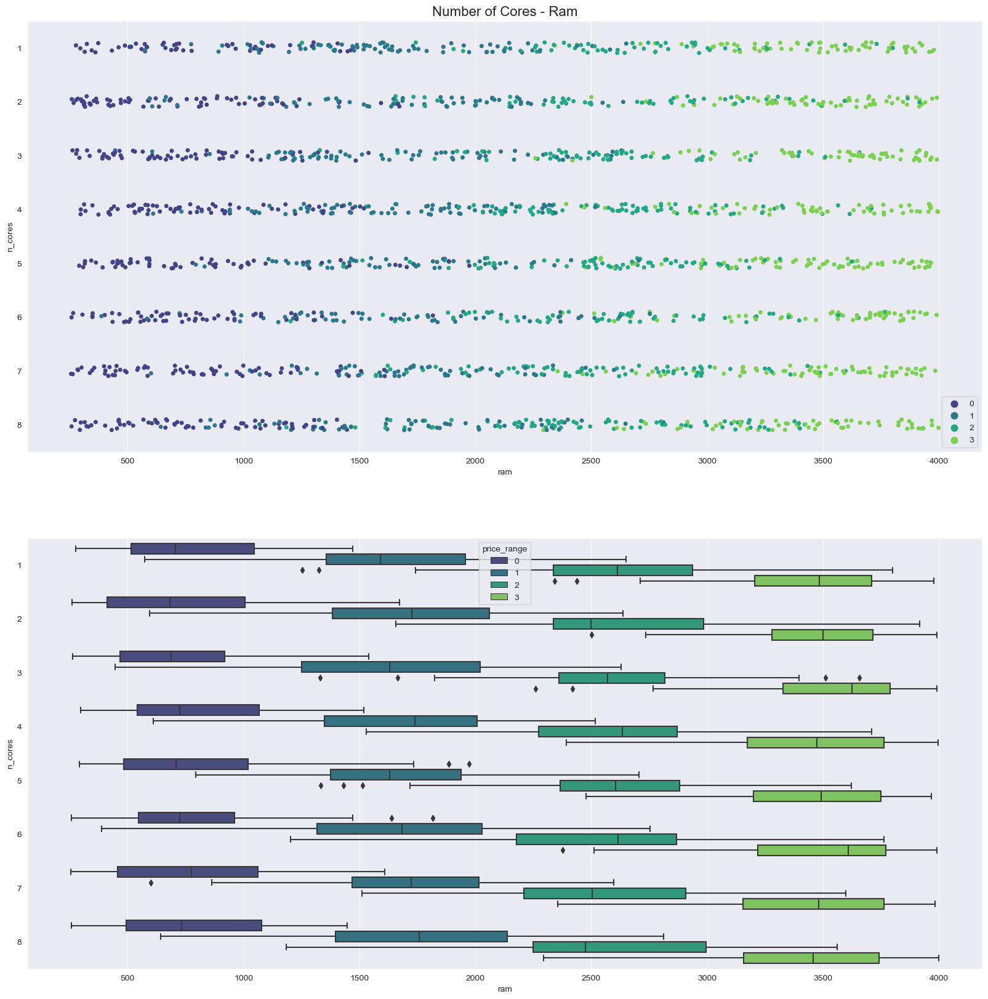

In [86]:
fig, axes = plt.subplots(2,1, figsize=(20,20))
sns.stripplot(data=Df, x='ram', palette='viridis', hue='price_range', y='n_cores', orient='h', ax=axes[0])
axes[0].set_title('Number of Cores - Ram', fontsize='16')
axes[0].legend(loc=4)
sns.boxplot(data=Df, x='ram', palette='viridis', hue='price_range', y='n_cores', orient='h', ax=axes[1])
plt.show()

#### 🎄3G - Ram:

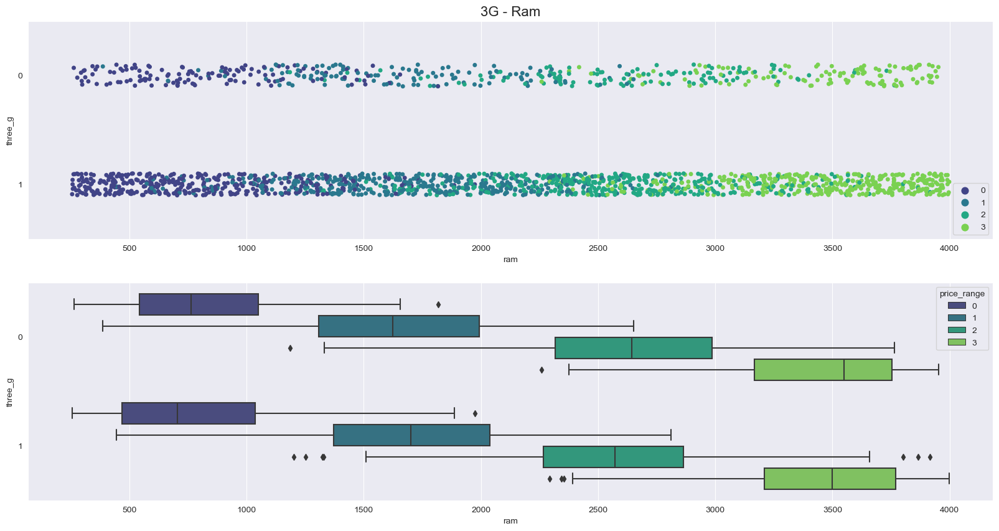

In [87]:
fig, axes = plt.subplots(2,1, figsize=(20,10))
sns.stripplot(data=Df, x='ram', palette='viridis', hue='price_range', y='three_g', orient='h', ax=axes[0])
axes[0].set_title('3G - Ram', fontsize='16')
axes[0].legend(loc=4)
sns.boxplot(data=Df, x='ram', palette='viridis', hue='price_range', y='three_g', orient='h', ax=axes[1])
plt.show()

#### 🎄Touch Screen - Ram:

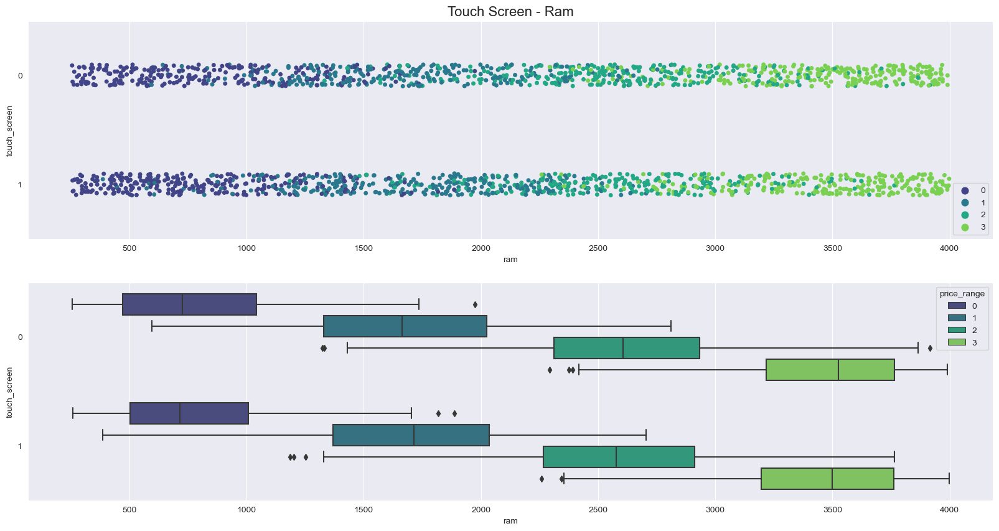

In [88]:
fig, axes = plt.subplots(2,1, figsize=(20,10))
sns.stripplot(data=Df, x='ram', palette='viridis', hue='price_range', y='touch_screen', orient='h', ax=axes[0])
axes[0].set_title('Touch Screen - Ram', fontsize='16')
axes[0].legend(loc=4)
sns.boxplot(data=Df, x='ram', palette='viridis', hue='price_range', y='touch_screen', orient='h', ax=axes[1])
plt.show()

#### 🎄Wifi - Ram:

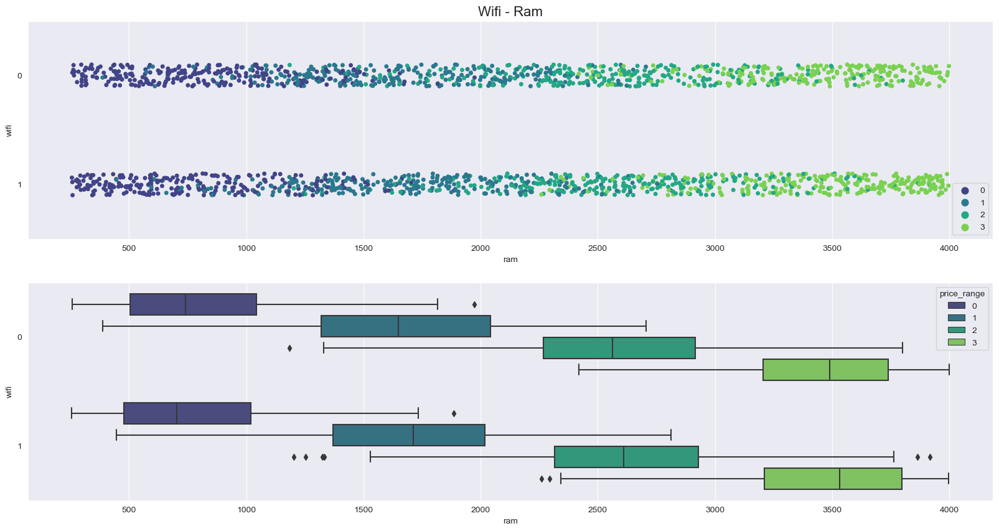

In [89]:
fig, axes = plt.subplots(2,1, figsize=(20,10))
sns.stripplot(data=Df, x='ram', palette='viridis', hue='price_range', y='wifi', orient='h', ax=axes[0])
axes[0].set_title('Wifi - Ram', fontsize='16')
axes[0].legend(loc=4)
sns.boxplot(data=Df, x='ram', palette='viridis', hue='price_range', y='wifi', orient='h', ax=axes[1])
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
 <strong>Observations:</strong> 
    <br>
    
- Overall, we observe that increasing the **RAM** in mobile phones leads to an increase in **price range** across all categorical features.

<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">5.6. Correlation</p>

<div style="background-color:#d5eae9; padding:20px; font-size:15px">

Our **target** is **Price Range**. So, we should check how each attribute correlates with the Price Range variable. We can do it as follows:

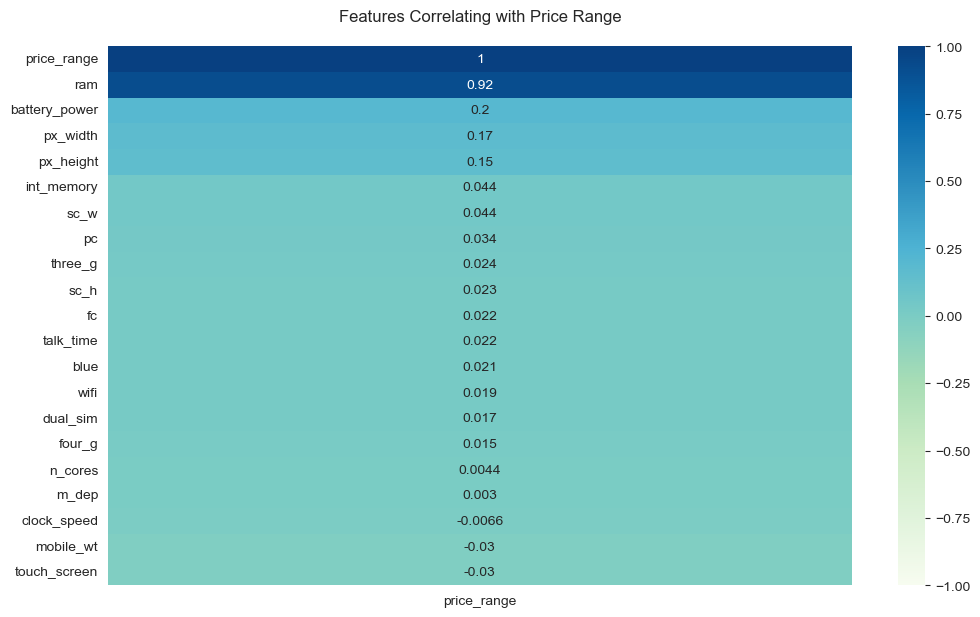

In [90]:
plt.figure (figsize = (12, 7), dpi = 100)
heatmap = sns.heatmap (Df.corr()[['price_range']].sort_values (by = 'price_range', ascending = False), vmin = -1, vmax = 1, annot = True, cmap = 'GnBu')
heatmap.set_title ('Features Correlating with Price Range', fontdict = {'fontsize':12}, pad = 18);

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
    <strong>Interpretation:</strong> 
    <br>

- The correlation coefficient ranges from **-1 to +1**.
- When it is close to +1, this signifies that there is a strong **positive correlation**. 
- So, we can see that there is a **positive correlation** between **Price Range** and **ram**, **Price Range** and **battery_power**, and **Price Range** and **px_width**.
- When it is close to -1, it means that there is a strong **negative correlation**. When it is close to 0, it means that there is **no correlation**.
- We can see that most of the variables except **clock_speed, mobile_wt** and **touch_screen** are positively correlated with the **target**.

### 🟢Correlation Between The Features

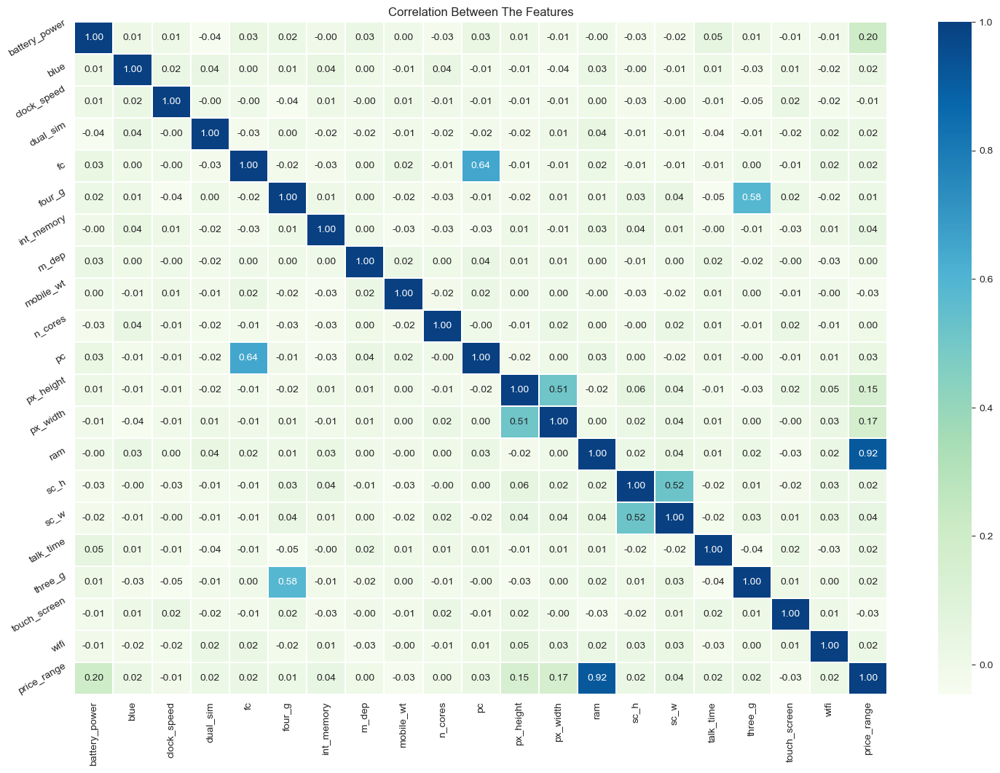

In [91]:
fig=plt.gcf()
fig.set_size_inches(18, 12)
plt.title('Correlation Between The Features')
a = sns.heatmap(Df.corr(), annot = True, cmap = 'GnBu', fmt='.2f', linewidths=0.2)
a.set_xticklabels(a.get_xticklabels(), rotation=90)
a.set_yticklabels(a.get_yticklabels(), rotation=30)
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
       <strong>Interpretation:</strong> 
    <br>
    
- There is a **strong** correlation between **ram** and **price_range**.
- In addition, the heatmap above indicates a **moderate** correlation between **4G** and **3G**, **fc** and **pc**, **px_height** and **px_width**, and **sc_h** and **sc_w**. 

<a id="1"></a>  
# <p style="padding:10px;background-color:#254441;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 15px 50px;overflow:hidden;font-weight:500">6. Model Building</p>

<center> <span style="font-family:newtimeroman"> <span style="padding:5px;display:fill;border-radius:20px 50px;background-color:#3a957f;font-size:200%;font-weight: 500;color:#254441;overflow:hidden;">ㅤ6.1. Decision Tree (DTs)ㅤ</span>

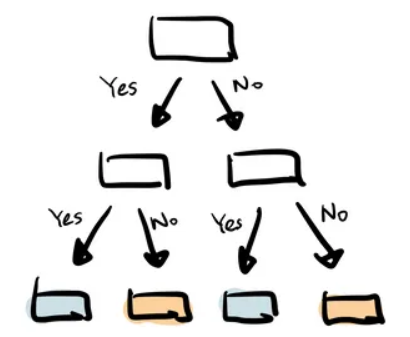

<div style="background-color:#d5eae9; padding:20px; font-size:15px">
    
**Decision Tree** is a machine learning algorithm used for classification and regression tasks. It creates a tree-like model by recursively partitioning the data based on the most discriminative features. Decision Tree can handle numerical and categorical data, is transparent and interpretable, and can be used for feature selection. However, Decision Tree is prone to overfitting, especially when the tree is deep and the data is noisy. Pruning, regularization, and ensemble methods can be used to prevent overfitting. Decision Tree has been applied in many machine learning applications, but careful attention should be paid to prevent overfitting and ensure optimal performance.

#### 🎄Declare Feature Vector and Target Variable

In [91]:
df = Df
X = df.drop('price_range', axis=1)
y = df['price_range'].values.reshape(-1, 1)

In [92]:
# Check the shape of X and y
print ('X:', X.shape,'\ny:', y.shape)

X: (2000, 20) 
y: (2000, 1)


#### 🎄Find the Best Test Size

In [93]:
# Array of test size value from 0.2 to 0.3
test_size = np.arange(start=0.2, stop=0.35, step= 0.05)

# Initialize a list where we'll store the score of each test size
score =[]
for size in test_size:
    X_train1, X_test1, y_train1, y_test1 = train_test_split (X, y, test_size=size, random_state=0)
    DT_Clf = DecisionTreeClassifier (max_depth=3)
    DT_Clf.fit (X_train1, y_train1)
    score.append (DT_Clf.score (X_test1, y_test1))

# Create a dataframe to display the results 
r= pd.DataFrame({'Test size': test_size , 'Score': score})
r.sort_values(by = ['Score'], ascending = False, inplace = True)
r.style.highlight_max(color='#acd9a8')

,Test size,Score
1,0.250000,0.764000
0,0.200000,0.757500
2,0.300000,0.748333


<div style="background-color:#e9f5f0; padding:10px; font-size:15px">

We consider the test size **0.25** for **Decision Tree** modeling. 

#### 🎄Train Test Split

In [94]:
# Split X and y into training and testing sets
X_train1, X_test1, y_train1, y_test1 = train_test_split (X, y, stratify=y, test_size = 0.25, random_state = 0)

In [95]:
# check the shape of X_train, X_test, y_train and y_test
print('X_train shape: ', X_train1.shape)
print('X_test shape: ', X_test1.shape)
print('y_train shape: ', y_train1.shape)
print('y_test shape: ', y_test1.shape)

X_train shape:  (1500, 20)
X_test shape:  (500, 20)
y_train shape:  (1500, 1)
y_test shape:  (500, 1)


#### 🎄Train Decision Tree Model

In [96]:
# Instantiate the model
DT_model = DecisionTreeClassifier(max_depth=3)

# Fit the model to the training set
DT_model.fit(X_train1, y_train1)

DecisionTreeClassifier(max_depth=3)

#### 🎄Predict X-test

In [97]:
y_pred = DT_model.predict(X_test1)

#### 🎄Check Accuracy Score

In [98]:
print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test1, y_pred)))

Model accuracy score: 0.7520


#### 🎄Check for overfitting and underfitting

In [99]:
# print the scores on training and test set
print('Training set score: {:.4f}'.format(DT_model.score(X_train1, y_train1)))
print('Test set score: {:.4f}'.format(DT_model.score(X_test1, y_test1)))

Training set score: 0.7693
Test set score: 0.7520


<div style="background-color:#e9f5f0; padding:20px; font-size:15px">

**Explanations:**
    
- The **training-set** accuracy score is **0.7693** while the **test-set** accuracy to be **0.7520**. These two values are quite comparable. So, there is no question of overfitting.

#### 🎄K-Fold Cross-validation

In [100]:
kf = KFold(n_splits=10, shuffle=False)

<IPython.core.display.Javascript object>

#### 🎄Cross Validation Accuracy

In [101]:
score = cross_val_score(DT_model, X_train1, y_train1, cv=kf, scoring='accuracy')
DT_model_cv_score = score.mean()
DT_model_cv_stdev = stdev(score)
print('Cross Validation Accuracy scores are:\n {}'.format(score))

<IPython.core.display.Javascript object>

Cross Validation Accuracy scores are:
 [0.72666667 0.76       0.77333333 0.74666667 0.74666667 0.68666667
 0.74       0.75333333 0.7        0.78      ]


In [102]:
Accuracy  = ['Cross Validation Accuracy ']
DT_A = pd.DataFrame({'CV Mean':DT_model_cv_score,'Std':DT_model_cv_stdev},index=Accuracy )
DT_A

,CV Mean,Std
Cross Validation Accuracy,0.741333,0.029781


<div style="background-color:#e9f5f0; padding:20px; font-size:15px">

**Interpretation:**

- Using the **mean cross-validation**, we can conclude that we expect the model to be around **74.13 %** accurate on average.
- We can see that 10-fold cross-validation accuracy **does not** result in performance improvement for this model.

#### 🎄Confusion Matrix

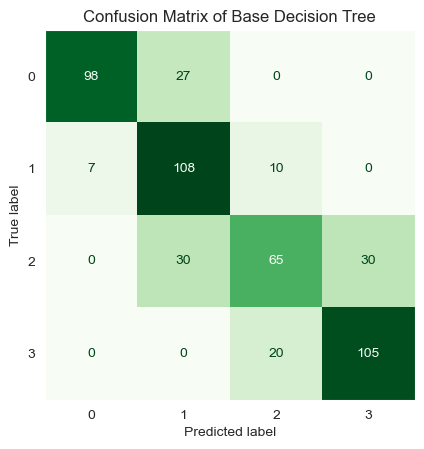

In [103]:
ConfusionMatrixDisplay.from_estimator(DT_model, X_test1, y_test1, colorbar=False, cmap='Greens')
plt.title('Confusion Matrix of Base Decision Tree')
plt.grid(False)

#### 🎄Classification Report

In [104]:
print(classification_report(y_test1, y_pred))

              precision    recall  f1-score   support

           0       0.93      0.78      0.85       125
           1       0.65      0.86      0.74       125
           2       0.68      0.52      0.59       125
           3       0.78      0.84      0.81       125

    accuracy                           0.75       500
   macro avg       0.76      0.75      0.75       500
weighted avg       0.76      0.75      0.75       500



#### 🎄Performance Metrics

In [105]:
def metrics_calculator(y_test, y_pred, model_name):
    '''
    This function calculates all desired performance metrics for a given model.
    '''
    result = pd.DataFrame(data=[accuracy_score(y_test, y_pred),
                                precision_score(y_test, y_pred, average='macro'),
                                recall_score(y_test, y_pred, average='macro'),
                                f1_score(y_test, y_pred, average='macro')],
                          index=['Accuracy','Precision','Recall','F1-score'],
                          columns = [model_name])
    return result

In [106]:
BaseDT_result = metrics_calculator(y_test1, y_pred, 'Base Decision Tree')
BaseDT_result

,Base Decision Tree
Accuracy,0.752000
Precision,0.762467
Recall,0.752000
F1-score,0.748901


#### 🎄ROC Curve

In [107]:
from sklearn.preprocessing import label_binarize

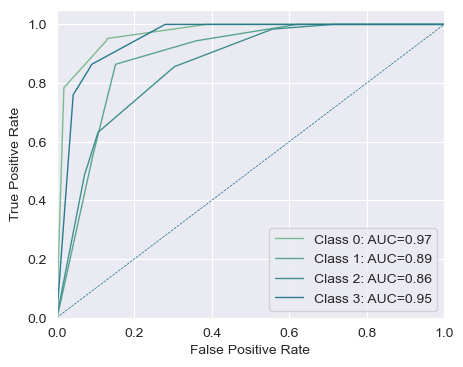

In [108]:
y_Pred_prob = DT_model.predict_proba(X_test1)

def roc_curve_plot(y_actual, y_predicted_probs, figsize=(5, 4), title=None, legend_loc='best'):

    # Compute ROC curve and ROC area for each class
    fpr = {}
    tpr = {}
    thres = {}
    roc_auc = {}

    n_class = y_predicted_probs.shape[1]
    for i in range(n_class):
        fpr[i], tpr[i], thres[i] = roc_curve(y_actual == i, y_predicted_probs[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Create a figure and plot the ROC curve for each class
    plt.figure(figsize=figsize)
    for i in range(n_class):
        plt.plot(fpr[i], tpr[i], linewidth=1, label='Class {}: AUC={:.2f}'.format(i, roc_auc[i]))

    # Add diagonal line and axis labels
    plt.plot([0, 1], [0, 1], '--', linewidth=0.5)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')

    # Set axis limits and add title and legend
    plt.xlim([0, 1])
    plt.ylim([0, 1.05])
    if title is not None:
        plt.title(title)
    plt.legend(loc=legend_loc)

    # Show the plot
    plt.show()
        
roc_curve_plot(y_test1, y_Pred_prob)

#### 🎄Plot Tree

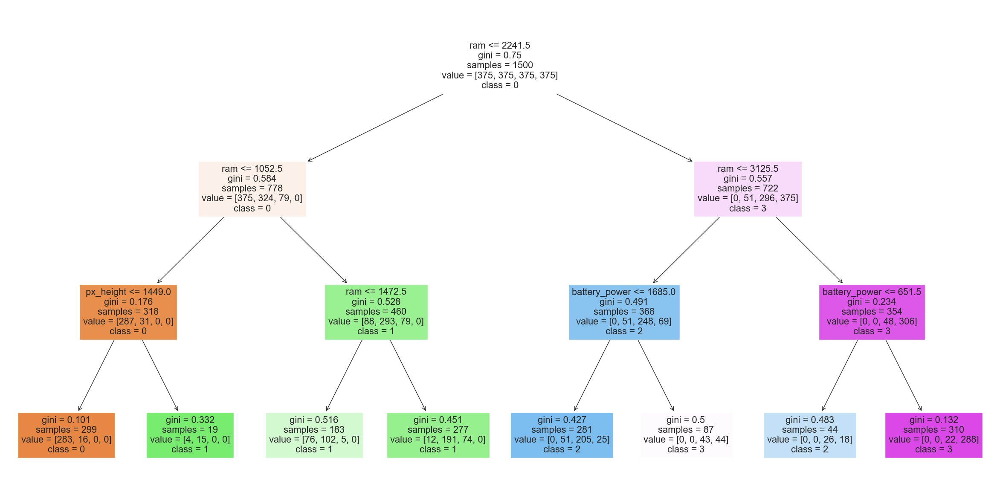

In [109]:
feature_names = X.columns
target_names = ["0", "1", "2", "3"]

fig = plt.figure(figsize = (30, 15))
Plot = tree.plot_tree (DT_model, feature_names = feature_names, class_names = target_names, filled = True)

#### 🎄Feature Importance

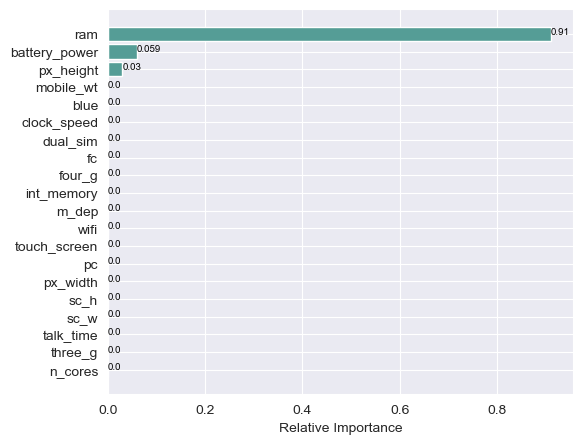

In [110]:
# Get feature importances from the Random Forest model
importances = DT_model.feature_importances_

# Sort the features by importance
indices = np.argsort(importances)

# Create a horizontal bar plot of the feature importances
plt.figure(figsize=(6, 5))
plt.barh(range(len(indices)), importances[indices], color='#559d96', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')

# Add labels to the bars
for i, v in enumerate(importances[indices]):
    plt.text(v, i, str(round(v, 3)), color='black', fontsize= 7)

plt.show()

<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">🟢Tune Decision Tree Hyperparameters Using GridSearchCV</p>

In [111]:
# Finding optimal hyperparameters(GridSearchCV)

# Define model
model = DecisionTreeClassifier()

# Define evaluation
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=0)

# Define search parameters
max_depth = range(2, 19, 1)
criterion = ['entropy', 'gini']   

#min_samples_split = [2, 3, 4]
#min_samples_leaf = [1, 2, 3]

param_grid = {'max_depth': max_depth, 'criterion':criterion}

# Define search
search = GridSearchCV(model, param_grid, scoring='accuracy', n_jobs=-1, cv=cv)

# Execute search
GridSearchCV = search.fit(X_train1, y_train1)

# Set the clf to the best combination of parameters
DT_modelcv = GridSearchCV.best_estimator_

# Summarize result
print('Best Score: %s' % GridSearchCV.best_score_)
print('Best Hyperparameters: %s' % GridSearchCV.best_params_)

Best Score: 0.8495555555555556
Best Hyperparameters: {'criterion': 'entropy', 'max_depth': 8}


### Tuned Decision Tree Model Evaluation

#### 🎄Train Tuned Model

In [112]:
DT_modelcv.fit(X_train1, y_train1)

DecisionTreeClassifier(criterion='entropy', max_depth=8)

#### 🎄Predict Tuned Model X-test

In [113]:
y_pred = DT_modelcv.predict(X_test1)

#### 🎄Check Tuned Model Accuracy Score

In [114]:
print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test1, y_pred)))

Model accuracy score: 0.8560


#### 🎄Tuned Model Confusion Matrix

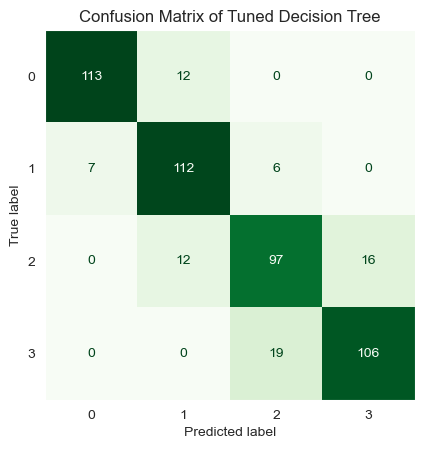

In [115]:
ConfusionMatrixDisplay.from_estimator(DT_modelcv, X_test1, y_test1, colorbar=False, cmap='Greens')
plt.title('Confusion Matrix of Tuned Decision Tree')
plt.grid(False)

#### 🎄Tuned Model Classification Report

In [116]:
print(classification_report(y_test1, y_pred))

              precision    recall  f1-score   support

           0       0.94      0.90      0.92       125
           1       0.82      0.90      0.86       125
           2       0.80      0.78      0.79       125
           3       0.87      0.85      0.86       125

    accuracy                           0.86       500
   macro avg       0.86      0.86      0.86       500
weighted avg       0.86      0.86      0.86       500



#### 🎄Tuned Model Performance Metrics

In [117]:
TunedDT_result = metrics_calculator(y_test1, y_pred, 'Tuned Decision Tree')
TunedDT_result

,Tuned Decision Tree
Accuracy,0.856000
Precision,0.857283
Recall,0.856000
F1-score,0.856103


#### 🎄ROC Curve

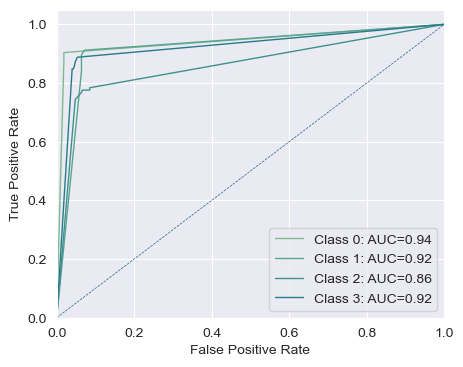

In [118]:
y_Pred_prob = DT_modelcv.predict_proba(X_test1)

def roc_curve_plot(y_actual, y_predicted_probs, figsize=(5, 4), title=None, legend_loc='best'):

    # Compute ROC curve and ROC area for each class
    fpr = {}
    tpr = {}
    thres = {}
    roc_auc = {}

    n_class = y_predicted_probs.shape[1]
    for i in range(n_class):
        fpr[i], tpr[i], thres[i] = roc_curve(y_actual == i, y_predicted_probs[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Create a figure and plot the ROC curve for each class
    plt.figure(figsize=figsize)
    for i in range(n_class):
        plt.plot(fpr[i], tpr[i], linewidth=1, label='Class {}: AUC={:.2f}'.format(i, roc_auc[i]))

    # Add diagonal line and axis labels
    plt.plot([0, 1], [0, 1], '--', linewidth=0.5)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')

    # Set axis limits and add title and legend
    plt.xlim([0, 1])
    plt.ylim([0, 1.05])
    if title is not None:
        plt.title(title)
    plt.legend(loc=legend_loc)

    # Show the plot
    plt.show()
        
roc_curve_plot(y_test1, y_Pred_prob)

#### 🎄Plot Tree

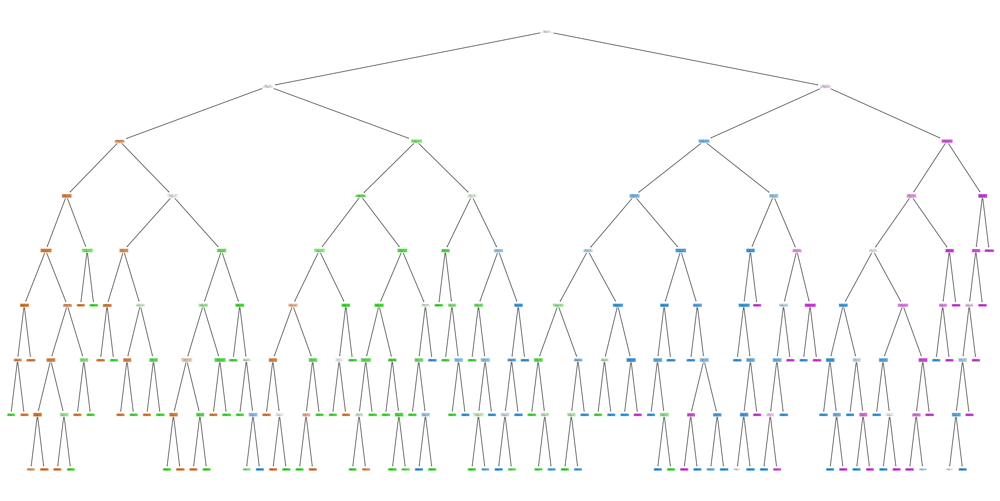

In [119]:
feature_names = X.columns
target_names = ["0", "1", "2", "3"]

fig = plt.figure(figsize = (30, 15))
Plot = tree.plot_tree (DT_modelcv, feature_names = feature_names, class_names = target_names, filled = True)

#### 🎄Tuned Model Feature Importance

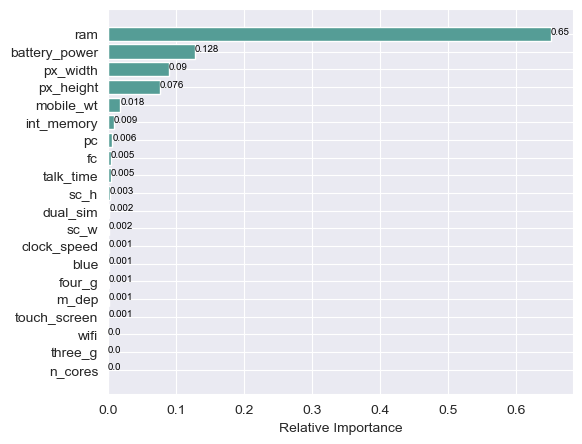

In [120]:
# Get feature importances from the Random Forest model
importances = DT_modelcv.feature_importances_

# Sort the features by importance
indices = np.argsort(importances)

# Create a horizontal bar plot of the feature importances
plt.figure(figsize=(6, 5))
plt.barh(range(len(indices)), importances[indices], color='#559d96', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')

# Add labels to the bars
for i, v in enumerate(importances[indices]):
    plt.text(v, i, str(round(v, 3)), color='black', fontsize= 7)

plt.show()

<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">🟢Cost Complexity Pruning</p>

<div style="background-color:#d5eae9; padding:20px; font-size:15px">

**Pruning** is a powerful technique used in machine learning and search algorithms to reduce the size of decision trees by removing non-critical and redundant sections. The main goal of pruning is to compress the data and simplify the final classifier, which helps to improve predictive accuracy and reduce overfitting.

In [121]:
# Create a decision tree classifier
clf = DecisionTreeClassifier()

# Generate the cost complexity pruning path for the decision tree using the training data
path = clf.cost_complexity_pruning_path(X_train1, y_train1)

# Extract the list of alphas and impurities from the pruning path
ccp_alphas = path.ccp_alphas
impurities = path.impurities

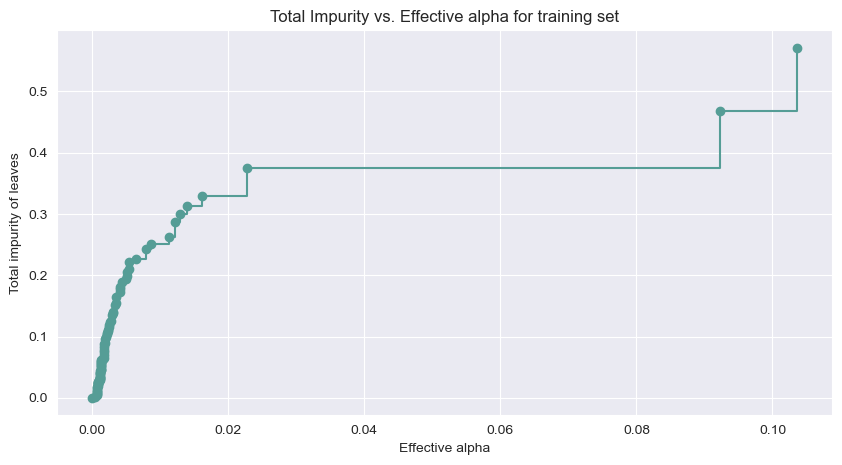

In [123]:
# Create a figure and axis object for the plot
fig, ax = plt.subplots(figsize=(10,5))

# Plot the total impurity vs. effective alpha using a step plot
ax.plot(ccp_alphas[:-1], impurities[:-1], marker='o', color='#559d96', drawstyle="steps-post")

# Set the x and y labels and title for the plot
ax.set_xlabel("Effective alpha")
ax.set_ylabel("Total impurity of leaves")
ax.set_title("Total Impurity vs. Effective alpha for training set")

# Show the plot
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">

**Explanations:**
    
- To train a pruned decision tree, we can set the **ccp_alpha** parameter of the DecisionTreeClassifier to these effective alpha values. We can then loop over the alpha values and fit a decision tree with each alpha value, and compute the accuracy of each pruned decision tree on both the training and test sets. By comparing the accuracy values at different alpha values, we can select the alpha value that results in the best balance between complexity and accuracy for our decision tree.

In [124]:
# Initialize empty lists to store classifier objects and evaluation metrics
clfs = []
accuracy_train = []
accuracy_test = []
recall_train = []
recall_test = []

# Loop through the values of ccp_alpha
for ccp_alpha in ccp_alphas:
    # Create a decision tree classifier object with the given value of ccp_alpha
    clf = DecisionTreeClassifier(ccp_alpha=ccp_alpha)
    
    # Fit the classifier to the training data
    clf.fit(X_train1, y_train1)
    
    # Generate predictions for the training and test sets
    y_train_pred = clf.predict(X_train1)
    y_test_pred = clf.predict(X_test1)
    
    # Compute and store the accuracy scores for the training and test sets
    accuracy_train.append(clf.score(X_train1, y_train1))
    accuracy_test.append(clf.score(X_test1, y_test1))
    
    # Compute and store the recall scores for the training and test sets
    recall_train.append(metrics.recall_score(y_train1, y_train_pred, average='micro'))
    recall_test.append(metrics.recall_score(y_test1, y_test_pred, average='micro'))
    
    # Store the classifier object in the list of classifiers
    clfs.append(clf)

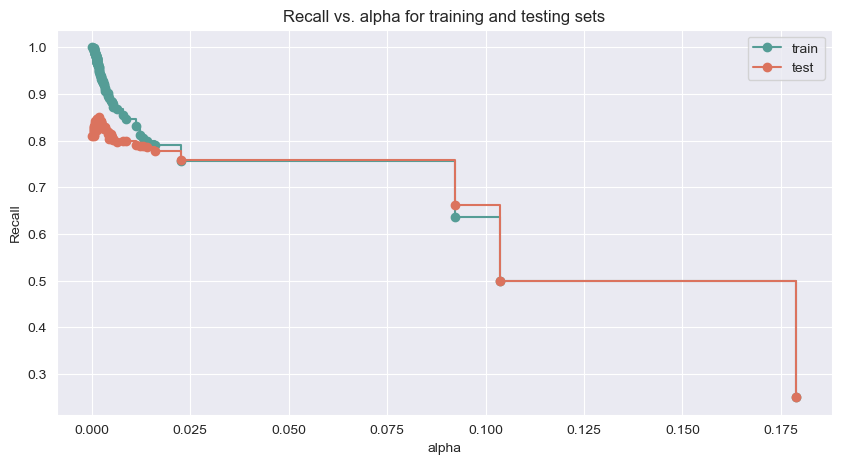

In [126]:
fig, ax = plt.subplots(figsize=(10, 5))

# Set the x-axis and y-axis label to "alpha" and "Recall"
ax.set_xlabel("alpha")
ax.set_ylabel("Recall")

# Set the title of the plot
ax.set_title("Recall vs. alpha for training and testing sets")

# Plot the recall scores for the training and test set as a function of ccp_alpha
ax.plot(ccp_alphas, recall_train, marker='o', label="train", drawstyle="steps-post", color='#559d96')
ax.plot(ccp_alphas, recall_test, marker='o', label="test", drawstyle="steps-post", color='#db735e')

# legend
ax.legend()
plt.show()

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">

**Explanations:**
    
- We get a **higher recall** in the test data at **0.0027** of **alpha**.

#### 🎄Train Pruning  Model

In [127]:
DT_Pruning = DecisionTreeClassifier(ccp_alpha= 0.0027, criterion= 'entropy', max_depth= 10)
DT_Pruning.fit(X_train1, y_train1)

DecisionTreeClassifier(ccp_alpha=0.0027, criterion='entropy', max_depth=10)

#### 🎄Predict X-test

In [128]:
y_pred = DT_Pruning.predict(X_test1)

#### 🎄Pruned Model Confusion Matrix

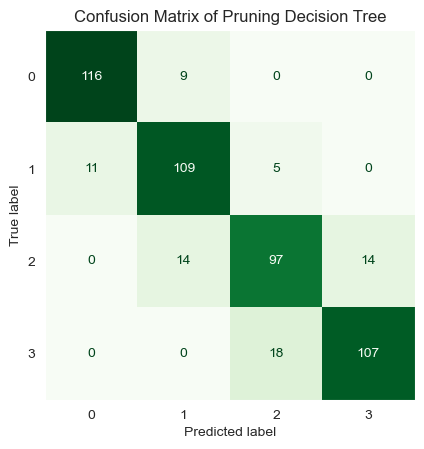

In [129]:
ConfusionMatrixDisplay.from_estimator(DT_Pruning, X_test1, y_test1, colorbar=False, cmap='Greens')
plt.title('Confusion Matrix of Pruning Decision Tree')
plt.grid(False)

#### 🎄Pruned Model Performance Metrics

In [130]:
DT_Pruning_result = metrics_calculator(y_test1, y_pred, 'Post-pruning Decision Tree')
DT_Pruning_result

,Post-pruning Decision Tree
Accuracy,0.858000
Precision,0.857944
Recall,0.858000
F1-score,0.857660


#### 🎄ROC Curve

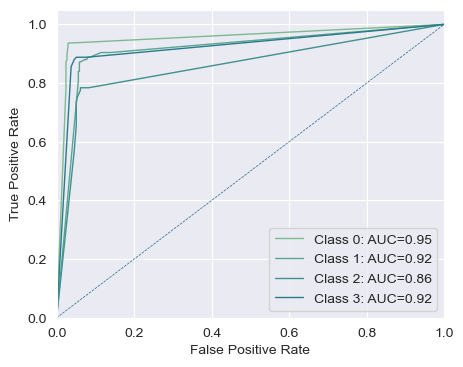

In [131]:
y_Pred_prob = DT_Pruning.predict_proba(X_test1)

def roc_curve_plot(y_actual, y_predicted_probs, figsize=(5, 4), title=None, legend_loc='best'):

    # Compute ROC curve and ROC area for each class
    fpr = {}
    tpr = {}
    thres = {}
    roc_auc = {}

    n_class = y_predicted_probs.shape[1]
    for i in range(n_class):
        fpr[i], tpr[i], thres[i] = roc_curve(y_actual == i, y_predicted_probs[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Create a figure and plot the ROC curve for each class
    plt.figure(figsize=figsize)
    for i in range(n_class):
        plt.plot(fpr[i], tpr[i], linewidth=1, label='Class {}: AUC={:.2f}'.format(i, roc_auc[i]))

    # Add diagonal line and axis labels
    plt.plot([0, 1], [0, 1], '--', linewidth=0.5)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')

    # Set axis limits and add title and legend
    plt.xlim([0, 1])
    plt.ylim([0, 1.05])
    if title is not None:
        plt.title(title)
    plt.legend(loc=legend_loc)

    # Show the plot
    plt.show()
        
roc_curve_plot(y_test1, y_Pred_prob)

#### 🎄Tuned Model Feature Importance

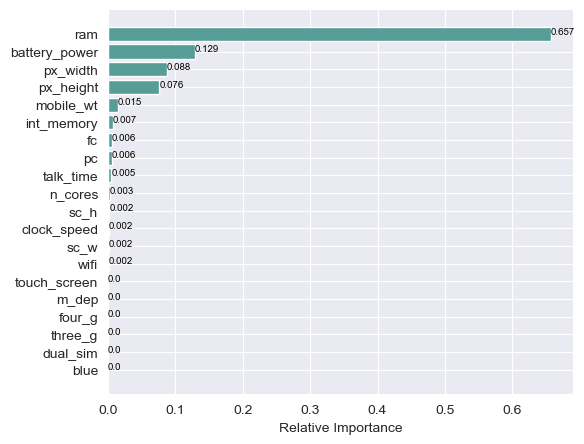

In [132]:
# Get feature importances from the Random Forest model
importances = DT_Pruning.feature_importances_

# Sort the features by importance
indices = np.argsort(importances)

# Create a horizontal bar plot of the feature importances
plt.figure(figsize=(6, 5))
plt.barh(range(len(indices)), importances[indices], color='#559d96', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')

# Add labels to the bars
for i, v in enumerate(importances[indices]):
    plt.text(v, i, str(round(v, 3)), color='black', fontsize= 7)

plt.show()

<center> <span style="font-family:newtimeroman"> <span style="padding:5px;display:fill;border-radius:20px 50px;background-color:#3a957f;font-size:200%;font-weight: 500;color:#254441;overflow:hidden;">ㅤ6.2. Random Forestㅤ</span>

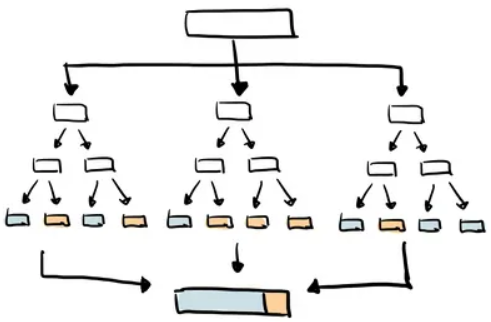

<div style="background-color:#d5eae9; padding:20px; font-size:15px">
    
**Random Forest** is an ensemble learning method used for classification and regression tasks. It constructs multiple decision trees at training time and outputs the mode (classification) or mean prediction (regression) of the individual tree predictions. Random Forest prevents overfitting by randomizing the selection of features and data samples used to build each tree, and it is able to handle high-dimensional data and missing values. Random Forest is used in a variety of applications, but it can be computationally expensive for large datasets and requires careful parameter tuning.

#### 🎄X and y Arrays

In [133]:
X = df.drop('price_range', axis=1)
y = df['price_range'].values.reshape(-1, 1)

In [134]:
print ('X:', X.shape,'\ny:', y.shape)

X: (2000, 20) 
y: (2000, 1)


#### 🎄Find the Best Test Size

In [136]:
# Array of test size value from 0.2 to 0.3
test_size = np.arange(start=0.2, stop=0.35, step=0.05)

# Initialize a list where we'll store the score of each test size
score = []
for size in test_size:
    X_train2, X_test2, y_train2, y_test2 = train_test_split (X, y, test_size=size, random_state=0)
    RF_model = RandomForestClassifier ()
    RF_model.fit (X_train2, y_train2)
    score.append (RF_model.score (X_test2, y_test2))
    
# Create a dataframe to display the results   
r= pd.DataFrame({'Test size': test_size, 'Score': score})
r.sort_values(by = ['Score'], ascending = False, inplace = True)
r.style.highlight_max(color='#acd9a8')

,Test size,Score
1,0.250000,0.886000
2,0.300000,0.866667
0,0.200000,0.862500


<div style="background-color:#e9f5f0; padding:10px; font-size:15px">

We consider the test size **0.25** for **Random Forest** modeling. 

#### 🎄Train Test Split

In [137]:
# Split X and y into training and testing sets
X_train2, X_test2, y_train2, y_test2 = train_test_split(X, y, stratify=y, test_size = 0.25, random_state = 0)

In [138]:
# check the shape of X_train, X_test, y_train and y_test
print('X_train shape:', X_train2.shape)
print('X_test shape:', X_test2.shape)
print('y_train shape:', y_train2.shape)
print('y_test shape:', y_test2.shape)

X_train shape: (1500, 20)
X_test shape: (500, 20)
y_train shape: (1500, 1)
y_test shape: (500, 1)


#### 🎄Train Random Forest Model

In [139]:
# Instantiate the model
RF_model = RandomForestClassifier()

# Fit the model to the training set
RF_model.fit(X_train2, y_train2)

RandomForestClassifier()

#### 🎄Predict X-test

In [140]:
y_pred = RF_model.predict(X_test2)

#### 🎄Check Accuracy Score

In [141]:
print('Model Accuracy Score: {0:0.4f}'. format(accuracy_score(y_test2, y_pred)))

Model Accuracy Score: 0.8860


#### 🎄Check for Overfitting and Underfitting

In [142]:
# Scores on training and test set
print('Training set score: {:.4f}'.format(RF_model.score(X_train2, y_train2)))
print('Test set score: {:.4f}'.format(RF_model.score(X_test2, y_test2)))

Training set score: 1.0000
Test set score: 0.8860


#### 🎄K-Fold Cross-validation

In [143]:
kf = KFold(n_splits=10, shuffle=False)

<IPython.core.display.Javascript object>

#### 🎄Cross Validation Accuracy

In [144]:
score = cross_val_score(RF_model, X_train2, y_train2, cv=kf, scoring='accuracy')
RF_model_cv_score = score.mean()
RF_model_cv_stdev = stdev(score)
print('Cross Validation Accuracy scores are:\n {}'.format(score))

<IPython.core.display.Javascript object>

Cross Validation Accuracy scores are:
 [0.86666667 0.87333333 0.82666667 0.86       0.84       0.82666667
 0.88666667 0.88666667 0.84666667 0.89333333]


In [145]:
Accuracy = ['Cross Validation Accuracy']
RF_A = pd.DataFrame({'CV Mean':RF_model_cv_score,'Std':RF_model_cv_stdev},index=Accuracy)
RF_A

,CV Mean,Std
Cross Validation Accuracy,0.860667,0.024835


<div style="background-color:#e9f5f0; padding:20px; font-size:15px">

**Interpretation:**

- Using the **mean cross-validation**, we can conclude that we expect the model to be around **86.8 %** accurate on average.
- We can see that 10-fold cross-validation accuracy **does not** result in performance improvement for this model.

#### 🎄Confusion Matrix

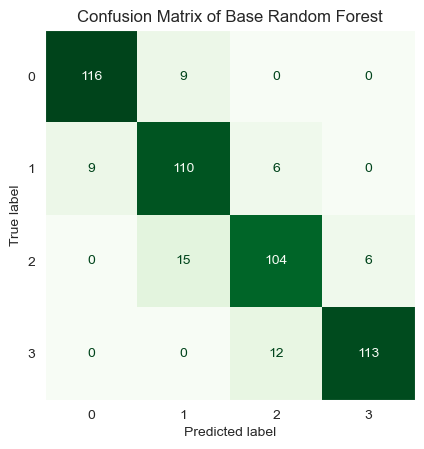

In [146]:
ConfusionMatrixDisplay.from_estimator(RF_model, X_test2, y_test2, colorbar=False, cmap='Greens')
plt.title('Confusion Matrix of Base Random Forest')
plt.grid(False)

#### 🎄Classification Report

In [147]:
print(classification_report(y_test2, y_pred))

              precision    recall  f1-score   support

           0       0.93      0.93      0.93       125
           1       0.82      0.88      0.85       125
           2       0.85      0.83      0.84       125
           3       0.95      0.90      0.93       125

    accuracy                           0.89       500
   macro avg       0.89      0.89      0.89       500
weighted avg       0.89      0.89      0.89       500



#### 🎄Performance Metrics

In [148]:
BaseRF_result = metrics_calculator(y_test2, y_pred, 'Base Random Forest')
BaseRF_result

,Base Random Forest
Accuracy,0.886000
Precision,0.887734
Recall,0.886000
F1-score,0.886439


#### 🎄ROC Curve

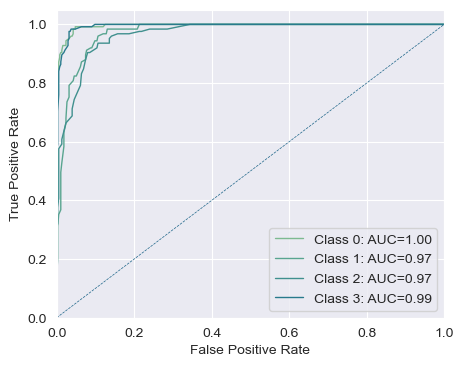

In [149]:
y_Pred_prob = RF_model.predict_proba(X_test2)

def roc_curve_plot(y_actual, y_predicted_probs, figsize=(5, 4), title=None, legend_loc='best'):

    # Compute ROC curve and ROC area for each class
    fpr = {}
    tpr = {}
    thres = {}
    roc_auc = {}

    n_class = y_predicted_probs.shape[1]
    for i in range(n_class):
        fpr[i], tpr[i], thres[i] = roc_curve(y_actual == i, y_predicted_probs[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Create a figure and plot the ROC curve for each class
    plt.figure(figsize=figsize)
    for i in range(n_class):
        plt.plot(fpr[i], tpr[i], linewidth=1, label='Class {}: AUC={:.2f}'.format(i, roc_auc[i]))

    # Add diagonal line and axis labels
    plt.plot([0, 1], [0, 1], '--', linewidth=0.5)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')

    # Set axis limits and add title and legend
    plt.xlim([0, 1])
    plt.ylim([0, 1.05])
    if title is not None:
        plt.title(title)
    plt.legend(loc=legend_loc)

    # Show the plot
    plt.show()
        
roc_curve_plot(y_test2, y_Pred_prob)

#### 🎄Plot Forest

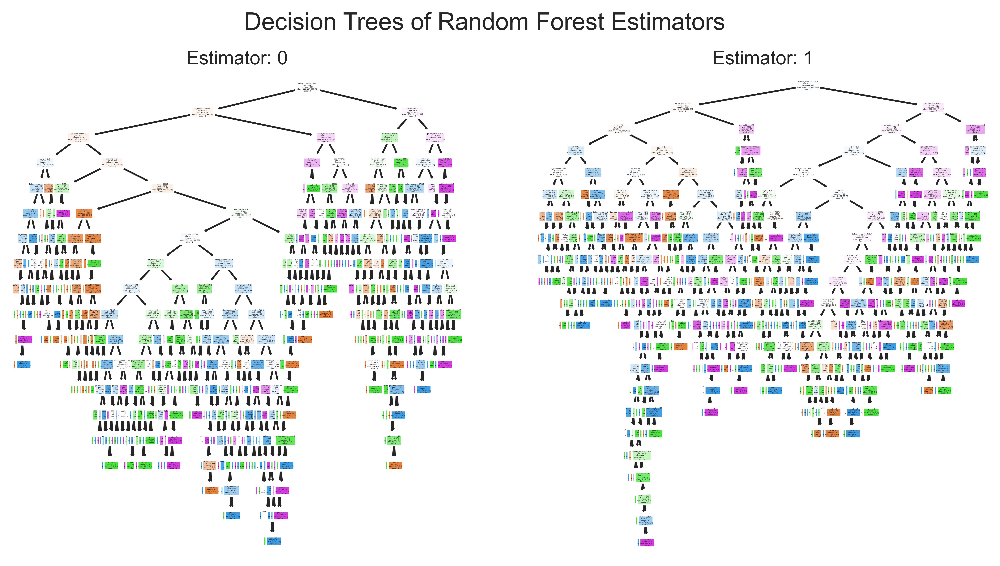

In [150]:
# Get the feature names and class names
fn = X.columns
cn = ["0", "1", "2", "3"]

# Create a figure with two subplots
fig, axes = plt.subplots(nrows = 1, ncols = 2, figsize = (10,5), dpi=900)

# Loop over the two estimators and plot the decision trees
for index in range(0, 2): # for example (2 Estimators)
    tree.plot_tree(RF_model.estimators_[index], feature_names = fn, class_names=cn, filled = True, ax = axes[index]);
    axes[index].set_title('Estimator: ' + str(index), fontsize = 11)
    
# Add overall title to the figure
fig.suptitle("Decision Trees of Random Forest Estimators", fontsize=14)
plt.show()

#### 🎄Random Forest Feature Importance

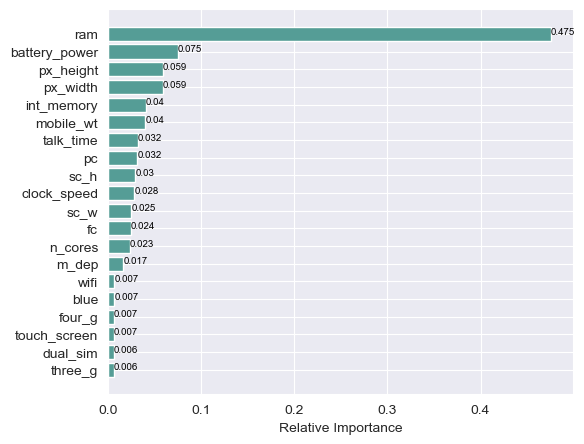

In [151]:
# Get feature importances from the Random Forest model
importances = RF_model.feature_importances_

# Sort the features by importance
indices = np.argsort(importances)

# Create a horizontal bar plot of the feature importances
plt.figure(figsize=(6, 5))
plt.barh(range(len(indices)), importances[indices], color='#559d96', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')

# Add labels to the bars
for i, v in enumerate(importances[indices]):
    plt.text(v, i, str(round(v, 3)), color='black', fontsize= 7)

plt.show()

<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">🟢Tune Random Forest Hyperparameters Using GridSearchCV</p>

In [152]:
# Finding optimal hyperparameters(GridSearchCV)
from sklearn.model_selection import GridSearchCV

# Define model
model = RandomForestClassifier()

# Define evaluation
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=0)

# Define search parameters   
n_estimators = [10, 50, 100, 200, 500]
max_depth = [None, 3, 4, 8, 9, 10, 11, 12]
criterion = ['gini', 'entropy']
max_features = ['sqrt', 'log2']

#min_samples_split = [2, 5, 10]
#min_samples_leaf = [1, 2, 4]

param_grid = {"n_estimators": n_estimators, "max_depth": max_depth, "criterion" : criterion, "max_features" : max_features} 

# Define search
search = GridSearchCV(model, param_grid, scoring='accuracy', n_jobs=-1, cv=cv)

# Execute search
GridSearchCV = search.fit(X_train2, y_train2)

# Set the clf to the best combination of parameters
RF_modelcv = GridSearchCV.best_estimator_

# Summarize result
print('Best Score: %s' % GridSearchCV.best_score_)
print('Best Hyperparameters: %s' % GridSearchCV.best_params_)

Best Score: 0.8788888888888888
Best Hyperparameters: {'criterion': 'entropy', 'max_depth': 12, 'max_features': 'log2', 'n_estimators': 500}


### Tuned Random Forest Model Evaluation

#### 🎄Train Tuned  Model

In [153]:
RF_modelcv.fit(X_train2, y_train2)

RandomForestClassifier(criterion='entropy', max_depth=12, max_features='log2',
                       n_estimators=500)

#### 🎄Predict Tuned Model X-test

In [154]:
y_pred = RF_modelcv.predict(X_test2)

#### 🎄Check Tuned Model Accuracy Score

In [155]:
print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test2, y_pred)))

Model accuracy score: 0.9060


#### 🎄Tuned Model Confusion Matrix

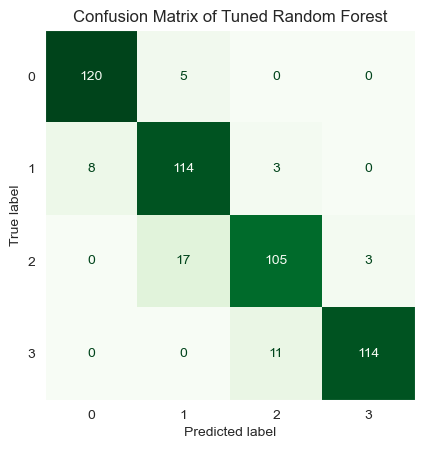

In [156]:
ConfusionMatrixDisplay.from_estimator(RF_modelcv, X_test2, y_test2, colorbar=False, cmap='Greens')
plt.title('Confusion Matrix of Tuned Random Forest')
plt.grid(False)

#### 🎄Tuned Model Classification Report

In [157]:
print(classification_report(y_test2, y_pred))

              precision    recall  f1-score   support

           0       0.94      0.96      0.95       125
           1       0.84      0.91      0.87       125
           2       0.88      0.84      0.86       125
           3       0.97      0.91      0.94       125

    accuracy                           0.91       500
   macro avg       0.91      0.91      0.91       500
weighted avg       0.91      0.91      0.91       500



#### 🎄Tuned Model Performance Metrics

In [158]:
TunedRF_result = metrics_calculator(y_test2, y_pred, 'Tuned Random Forest')
TunedRF_result

,Tuned Random Forest
Accuracy,0.906000
Precision,0.908112
Recall,0.906000
F1-score,0.906246


#### 🎄ROC Curve

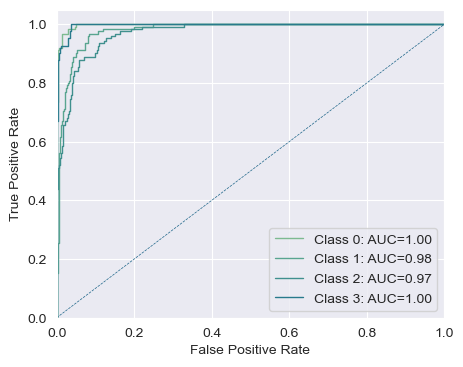

In [159]:
y_Pred_prob = RF_modelcv.predict_proba(X_test2)

def roc_curve_plot(y_actual, y_predicted_probs, figsize=(5, 4), title=None, legend_loc='best'):

    # Compute ROC curve and ROC area for each class
    fpr = {}
    tpr = {}
    thres = {}
    roc_auc = {}

    n_class = y_predicted_probs.shape[1]
    for i in range(n_class):
        fpr[i], tpr[i], thres[i] = roc_curve(y_actual == i, y_predicted_probs[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Create a figure and plot the ROC curve for each class
    plt.figure(figsize=figsize)
    for i in range(n_class):
        plt.plot(fpr[i], tpr[i], linewidth=1, label='Class {}: AUC={:.2f}'.format(i, roc_auc[i]))

    # Add diagonal line and axis labels
    plt.plot([0, 1], [0, 1], '--', linewidth=0.5)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')

    # Set axis limits and add title and legend
    plt.xlim([0, 1])
    plt.ylim([0, 1.05])
    if title is not None:
        plt.title(title)
    plt.legend(loc=legend_loc)

    # Show the plot
    plt.show()
        
roc_curve_plot(y_test2, y_Pred_prob)

#### 🎄Plot Forest

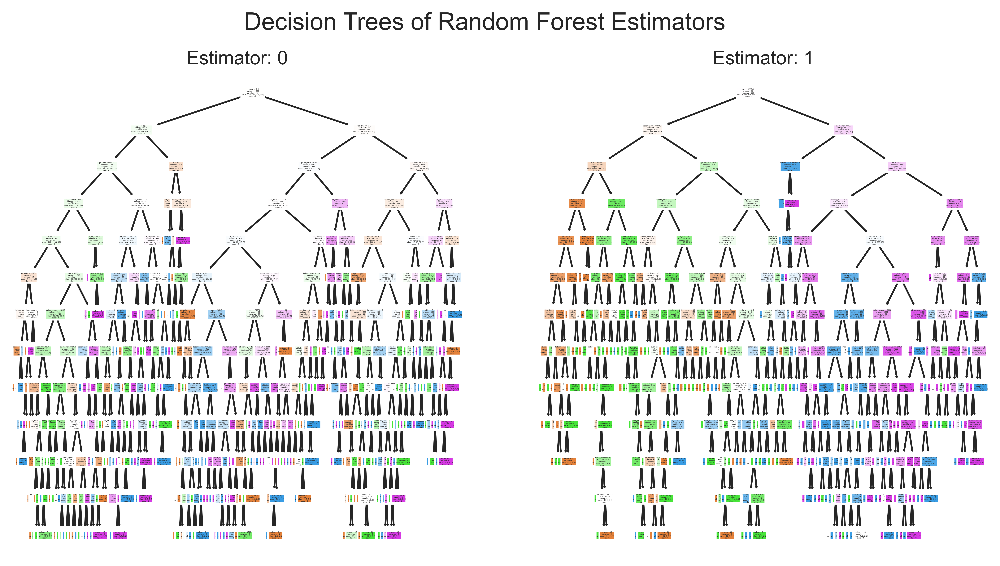

In [160]:
# Get the feature names and class names
fn = X.columns
cn = ["0", "1", "2", "3"]

# Create a figure with two subplots
fig, axes = plt.subplots(nrows = 1, ncols = 2, figsize = (10,5), dpi=900)

# Loop over the two estimators and plot the decision trees
for index in range(0, 2): # for example (2 Estimators)
    tree.plot_tree(RF_modelcv.estimators_[index], feature_names = fn, class_names=cn, filled = True, ax = axes[index]);
    axes[index].set_title('Estimator: ' + str(index), fontsize = 11)
    
# Add overall title to the figure
fig.suptitle("Decision Trees of Random Forest Estimators", fontsize=14)
plt.show()

#### 🎄Tuned Model Feature Importance

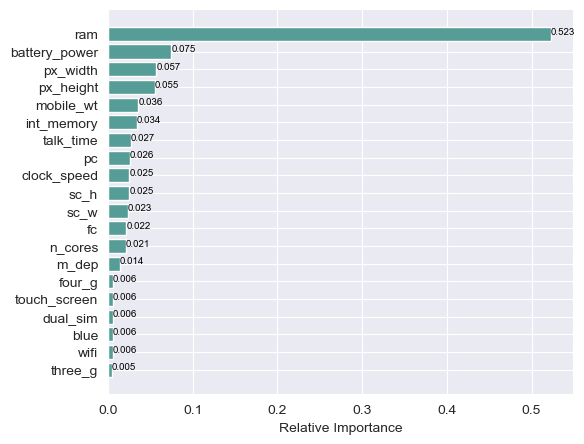

In [161]:
# Get feature importances from the Random Forest model
importances = RF_modelcv.feature_importances_

# Sort the features by importance
indices = np.argsort(importances)

# Create a horizontal bar plot of the feature importances
plt.figure(figsize=(6, 5))
plt.barh(range(len(indices)), importances[indices], color='#559d96', align='center')
plt.yticks(range(len(indices)), [feature_names[i] for i in indices])
plt.xlabel('Relative Importance')

# Add labels to the bars
for i, v in enumerate(importances[indices]):
    plt.text(v, i, str(round(v, 3)), color='black', fontsize= 7)

plt.show()

<center> <span style="font-family:newtimeroman"> <span style="padding:5px;display:fill;border-radius:20px 50px;background-color:#3a957f;font-size:200%;font-weight: 500;color:#254441;overflow:hidden;">ㅤ6.3. Support Vector Machine (SVM)ㅤ</span>

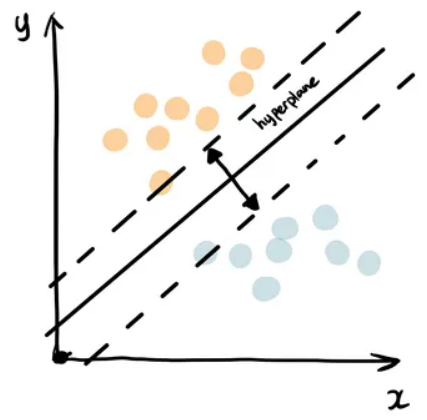

<div style="background-color:#d5eae9; padding:20px; font-size:15px">
    
**Support Vector Machine (SVM)** is a popular machine learning algorithm used for classification, regression, and outlier detection tasks. The main idea behind SVM is to find the hyperplane that best separates the data into different classes. The hyperplane is chosen such that it maximizes the margin, which is the distance between the hyperplane and the closest data points from both classes. SVM is effective in dealing with both linearly separable and non-linearly separable data by transforming the data into a higher-dimensional space where the data becomes linearly separable. This is done using a kernel function, which allows SVM to work with complex data distributions without explicitly computing the transformed feature space. SVM has several advantages over other machine learning algorithms, including its ability to handle high-dimensional data, its ability to work with small and large datasets, and its robustness to overfitting. SVM has been successfully applied in a wide range of applications, including image and text classification, bioinformatics, and finance. However, SVM can be computationally expensive for large datasets and requires careful parameter tuning to achieve optimal performance.

#### 🎄X and y Arrays

In [162]:
X = df.drop('price_range', axis=1)
y = df['price_range'].values.reshape(-1, 1)

In [163]:
print ('X:', X.shape,'\ny:', y.shape)

X: (2000, 20) 
y: (2000, 1)


#### 🎄Find the Best Test Size

In [164]:
# Array of test size value from 0.2 to 0.3
test_size = np.arange(start=0.2, stop=0.35, step=0.05)

# Initialize a list where we'll store the score of each test size
score = []
for size in test_size:
    X_train3, X_test3, y_train3, y_test3 = train_test_split (X, y, test_size=size, random_state=0)
    svm_model = svm.SVC()
    svm_model.fit (X_train3, y_train3)
    score.append (svm_model.score (X_test3, y_test3))
    
# Create a dataframe to display the results   
r= pd.DataFrame({'Test size': test_size, 'Score': score})
r.sort_values(by = ['Score'], ascending = False, inplace = True)
r.style.highlight_max(color='#acd9a8')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

,Test size,Score
0,0.200000,0.955000
1,0.250000,0.954000
2,0.300000,0.948333


<div style="background-color:#e9f5f0; padding:10px; font-size:15px">

We consider the test size **0.2** for **SVM** modeling. 

#### 🎄Train Test Split

In [165]:
# Split X and y into training and testing sets
X_train3, X_test3, y_train3, y_test3 = train_test_split (X, y, stratify=y, test_size = 0.2 , random_state = 0)

In [166]:
# check the shape of X_train, X_test, y_train and y_test
print('X_train shape:', X_train3.shape)
print('X_test shape:', X_test3.shape)
print('y_train shape:', y_train3.shape)
print('y_test shape:', y_test3.shape)

X_train shape: (1600, 20)
X_test shape: (400, 20)
y_train shape: (1600, 1)
y_test shape: (400, 1)


#### 🎄Feature Scaling

In [167]:
# Scale the features using StandardScaler
scaler = StandardScaler()

# Fit the scaler to the training data and transform it
X_train3 = scaler.fit_transform(X_train3)

# Transform the test data using the same scaler
X_test3 = scaler.transform(X_test3)

#### 🎄Train SVM Model

In [168]:
# Instantiate the model
svm_model = svm.SVC(probability=True)

# Fit the model to the training set
svm_model.fit(X_train3, y_train3)

<IPython.core.display.Javascript object>

SVC(probability=True)

#### 🎄Predict X-test

In [169]:
y_pred = svm_model.predict(X_test3)

#### 🎄Check Accuracy Score

In [170]:
print('Model Accuracy Score: {0:0.4f}'. format(accuracy_score(y_test3, y_pred)))

Model Accuracy Score: 0.8875


#### 🎄Check for Overfitting and Underfitting

In [171]:
# Scores on training and test set
print('Training set score: {:.4f}'.format(svm_model.score(X_train3, y_train3)))
print('Test set score: {:.4f}'.format(svm_model.score(X_test3, y_test3)))

Training set score: 0.9838
Test set score: 0.8875


#### 🎄K-Fold Cross-validation

In [172]:
kf = KFold(n_splits=10, shuffle=False)

<IPython.core.display.Javascript object>

#### 🎄Cross Validation Accuracy

In [173]:
score = cross_val_score(svm_model, X_train3, y_train3, cv=kf, scoring='accuracy')
svm_model_cv_score = score.mean()
svm_model_cv_stdev = stdev(score)
print('Cross Validation Accuracy scores are:\n {}'.format(score))

<IPython.core.display.Javascript object>

Cross Validation Accuracy scores are:
 [0.83125 0.8625  0.8875  0.88125 0.85    0.85    0.84375 0.89375 0.875
 0.85625]


In [174]:
Accuracy = ['Cross Validation Accuracy']
svm_A = pd.DataFrame({'CV Mean':svm_model_cv_score,'Std':svm_model_cv_stdev},index=Accuracy)
svm_A

,CV Mean,Std
Cross Validation Accuracy,0.863125,0.020508


<div style="background-color:#e9f5f0; padding:20px; font-size:15px">

**Interpretation:**

- Using the **mean cross-validation**, we can conclude that we expect the model to be around **86.31 %** accurate on average.
- We can see that 10-fold cross-validation accuracy **does not** result in performance improvement for this model.

#### 🎄Confusion Matrix

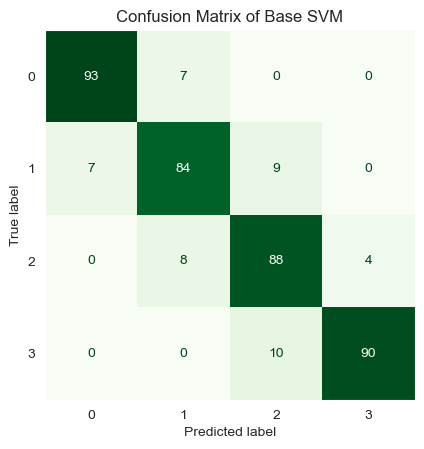

In [175]:
ConfusionMatrixDisplay.from_estimator(svm_model, X_test3, y_test3, colorbar=False, cmap='Greens')
plt.title('Confusion Matrix of Base SVM')
plt.grid(False)

#### 🎄Classification Report

In [176]:
print(classification_report(y_test3, y_pred))

              precision    recall  f1-score   support

           0       0.93      0.93      0.93       100
           1       0.85      0.84      0.84       100
           2       0.82      0.88      0.85       100
           3       0.96      0.90      0.93       100

    accuracy                           0.89       400
   macro avg       0.89      0.89      0.89       400
weighted avg       0.89      0.89      0.89       400



#### 🎄Performance Metrics

In [177]:
BaseSVM_result = metrics_calculator(y_test3, y_pred, 'Base SVM')
BaseSVM_result

,Base SVM
Accuracy,0.887500
Precision,0.889590
Recall,0.887500
F1-score,0.888074


#### 🎄Roc Curve

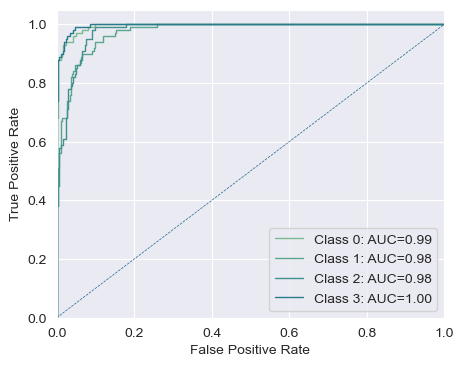

In [178]:
y_Pred_prob = svm_model.predict_proba(X_test3)

def roc_curve_plot(y_actual, y_predicted_probs, figsize=(5, 4), title=None, legend_loc='best'):

    # Compute ROC curve and ROC area for each class
    fpr = {}
    tpr = {}
    thres = {}
    roc_auc = {}

    n_class = y_predicted_probs.shape[1]
    for i in range(n_class):
        fpr[i], tpr[i], thres[i] = roc_curve(y_actual == i, y_predicted_probs[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Create a figure and plot the ROC curve for each class
    plt.figure(figsize=figsize)
    for i in range(n_class):
        plt.plot(fpr[i], tpr[i], linewidth=1, label='Class {}: AUC={:.2f}'.format(i, roc_auc[i]))

    # Add diagonal line and axis labels
    plt.plot([0, 1], [0, 1], '--', linewidth=0.5)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')

    # Set axis limits and add title and legend
    plt.xlim([0, 1])
    plt.ylim([0, 1.05])
    if title is not None:
        plt.title(title)
    plt.legend(loc=legend_loc)

    # Show the plot
    plt.show()
        
roc_curve_plot(y_test3, y_Pred_prob)

<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">🟢Tune SVM Hyperparameters Using GridSearchCV</p>

In [179]:
# Finding optimal hyperparameters(GridSearchCV)
from sklearn.model_selection import GridSearchCV

# Define model
model = svm.SVC(probability=True)

# Define evaluation
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=0)

# Define search parameters   
C = [0.1, 1, 10, 100]
kernel = ['linear', 'poly', 'rbf', 'sigmoid']
gamma = ['scale', 'auto']

#degree = [2, 3, 4]
#coef0 = [0, 1, 2]

param_grid = {'C': C, 'kernel': kernel, 'gamma': gamma} 

# Define search
search = GridSearchCV(model, param_grid, scoring='accuracy', n_jobs=-1, cv=cv)

# Execute search
GridSearchCV = search.fit(X_train3, y_train3)

# Set the clf to the best combination of parameters
svm_modelcv = GridSearchCV.best_estimator_

# Summarize result
print('Best Score: %s' % GridSearchCV.best_score_)
print('Best Hyperparameters: %s' % GridSearchCV.best_params_)

<IPython.core.display.Javascript object>

Best Score: 0.9654166666666667
Best Hyperparameters: {'C': 10, 'gamma': 'scale', 'kernel': 'linear'}


### Tuned SVM Model Evaluation

#### 🎄Train Tuned  Model

In [180]:
svm_modelcv.fit(X_train3, y_train3)

SVC(C=10, kernel='linear', probability=True)

#### 🎄Predict Tuned Model X-test

In [181]:
y_pred = svm_modelcv.predict(X_test3)

#### 🎄Check Tuned Model Accuracy Score

In [182]:
print('Model accuracy score: {0:0.4f}'. format(accuracy_score(y_test3, y_pred)))

Model accuracy score: 0.9750


#### 🎄Tuned Model Confusion Matrix

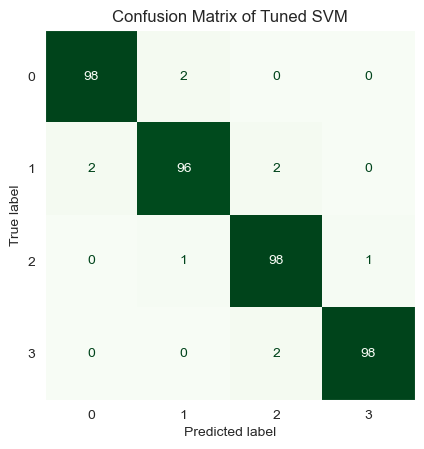

In [183]:
ConfusionMatrixDisplay.from_estimator(svm_modelcv, X_test3, y_test3, colorbar=False, cmap='Greens')
plt.title('Confusion Matrix of Tuned SVM')
plt.grid(False)

#### 🎄Tuned Model Classification Report

In [184]:
print(classification_report(y_test3, y_pred))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98       100
           1       0.97      0.96      0.96       100
           2       0.96      0.98      0.97       100
           3       0.99      0.98      0.98       100

    accuracy                           0.97       400
   macro avg       0.98      0.97      0.98       400
weighted avg       0.98      0.97      0.98       400



#### 🎄Tuned Model Performance Metrics

In [185]:
TunedSVM_result = metrics_calculator(y_test3, y_pred, 'Tuned SVM')
TunedSVM_result

,Tuned SVM
Accuracy,0.975000
Precision,0.975095
Recall,0.975000
F1-score,0.975011


#### 🎄Roc Curve

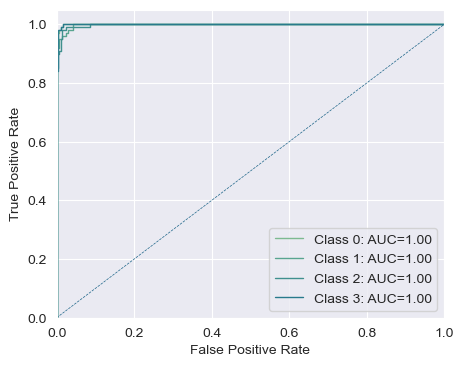

In [186]:
y_Pred_prob = svm_modelcv.predict_proba(X_test3)

def roc_curve_plot(y_actual, y_predicted_probs, figsize=(5, 4), title=None, legend_loc='best'):

    # Compute ROC curve and ROC area for each class
    fpr = {}
    tpr = {}
    thres = {}
    roc_auc = {}

    n_class = y_predicted_probs.shape[1]
    for i in range(n_class):
        fpr[i], tpr[i], thres[i] = roc_curve(y_actual == i, y_predicted_probs[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Create a figure and plot the ROC curve for each class
    plt.figure(figsize=figsize)
    for i in range(n_class):
        plt.plot(fpr[i], tpr[i], linewidth=1, label='Class {}: AUC={:.2f}'.format(i, roc_auc[i]))

    # Add diagonal line and axis labels
    plt.plot([0, 1], [0, 1], '--', linewidth=0.5)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')

    # Set axis limits and add title and legend
    plt.xlim([0, 1])
    plt.ylim([0, 1.05])
    if title is not None:
        plt.title(title)
    plt.legend(loc=legend_loc)

    # Show the plot
    plt.show()
        
roc_curve_plot(y_test3, y_Pred_prob)

<a id="1"></a>  
# <p style="padding:10px;background-color:#254441;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 15px 50px;overflow:hidden;font-weight:500">7. Conclusion</p>

#### 🎄Test Size Used for each Models

|               | Base Decision Tree | Tuned Decision Tree | Post-pruning Decision Tree | Base Random Forest | Tuned Random Forest | Base SVM | Tuned SVM |
| ------------- | ------------- | -------------- | ---------------------- | -------- | --------- | -------- | --------- |
| **Test Size** |      0.25      |       0.25      |          0.25           |   0.25   |    0.25   |    0.2  |    0.2   |

#### 🎄Comparison Performance Metrics of different Classification Models

In [187]:
Conclusion = pd.concat([BaseDT_result, TunedDT_result, DT_Pruning_result, BaseRF_result, TunedRF_result, BaseSVM_result, TunedSVM_result], axis=1)
Conclusion

,Base Decision Tree,Tuned Decision Tree,Post-pruning Decision Tree,Base Random Forest,Tuned Random Forest,Base SVM,Tuned SVM
Accuracy,0.752000,0.856000,0.858000,0.886000,0.906000,0.887500,0.975000
Precision,0.762467,0.857283,0.857944,0.887734,0.908112,0.889590,0.975095
Recall,0.752000,0.856000,0.858000,0.886000,0.906000,0.887500,0.975000
F1-score,0.748901,0.856103,0.857660,0.886439,0.906246,0.888074,0.975011


<div style="background-color:#e9f5f0; padding:20px; font-size:15px">

- ✅Best **Accuracy**  ➡️  **Tuned SVM**
- ✅Best **Precision** ➡️  **Tuned SVM**
- ✅Best **Recall**    ➡️  **Tuned SVM**
- ✅Best **F1-score**  ➡️  **Tuned SVM**	

#### 🎄Comparison Confusion Matrix of different Classification Models

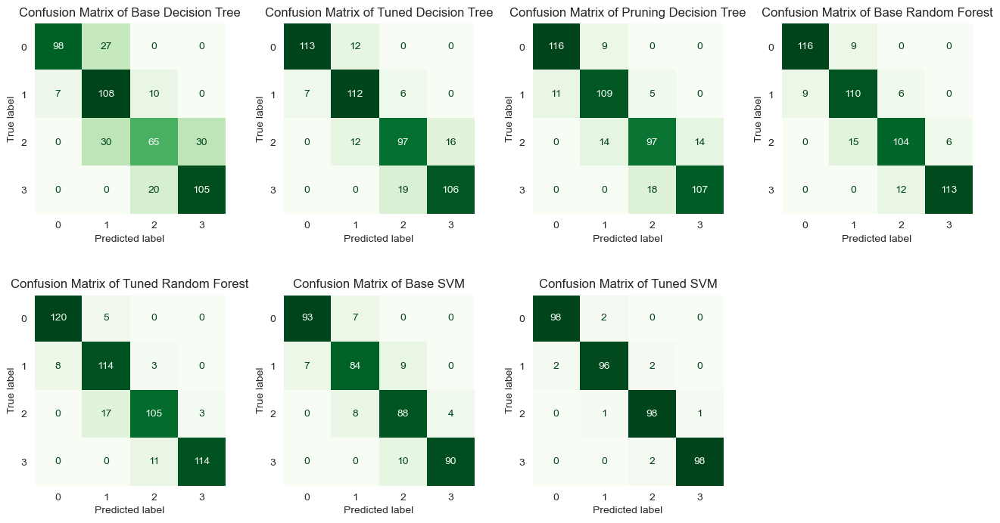

In [188]:
# Create subplots with 2 rows and 4 columns
fig, axs = plt.subplots(nrows=2, ncols=4, figsize=(16,8))

# Plot confusion matrix for Base Decision Tree
ax = axs[0, 0]
disp = ConfusionMatrixDisplay.from_estimator(DT_model, X_test1, y_test1, colorbar=False, cmap='Greens', ax=ax)
disp.ax_.set_title('Confusion Matrix of Base Decision Tree')
disp.ax_.grid(False)

# Plot confusion matrix for Tuned Decision Tree
ax = axs[0, 1]
disp = ConfusionMatrixDisplay.from_estimator(DT_modelcv, X_test1, y_test1, colorbar=False, cmap='Greens', ax=ax)
disp.ax_.set_title('Confusion Matrix of Tuned Decision Tree')
disp.ax_.grid(False)

# Plot confusion matrix for Pruning Decision Tree
ax = axs[0, 2]
disp = ConfusionMatrixDisplay.from_estimator(DT_Pruning, X_test1, y_test1, colorbar=False, cmap='Greens', ax=ax)
disp.ax_.set_title('Confusion Matrix of Pruning Decision Tree')
disp.ax_.grid(False)

# Plot confusion matrix for Base Random Forest
ax = axs[0, 3]
disp = ConfusionMatrixDisplay.from_estimator(RF_model, X_test2, y_test2, colorbar=False, cmap='Greens', ax=ax)
disp.ax_.set_title('Confusion Matrix of Base Random Forest')
disp.ax_.grid(False)

# Plot confusion matrix for Tuned Random Forest
ax = axs[1, 0]
disp = ConfusionMatrixDisplay.from_estimator(RF_modelcv, X_test2, y_test2, colorbar=False, cmap='Greens', ax=ax)
disp.ax_.set_title('Confusion Matrix of Tuned Random Forest')
disp.ax_.grid(False)

# Plot confusion matrix for Base SVM
ax = axs[1, 1]
disp = ConfusionMatrixDisplay.from_estimator(svm_model, X_test3, y_test3, colorbar=False, cmap='Greens', ax=ax)
disp.ax_.set_title('Confusion Matrix of Base SVM')
disp.ax_.grid(False)

# Plot confusion matrix for Tuned SVM
ax = axs[1, 2]
disp = ConfusionMatrixDisplay.from_estimator(svm_modelcv, X_test3, y_test3, colorbar=False, cmap='Greens', ax=ax)
disp.ax_.set_title('Confusion Matrix of Tuned SVM')
disp.ax_.grid(False)

# Hide the last subplot
axs[1, 3].axis('off')

# Adjust spacing between subplots
plt.subplots_adjust(hspace=0.4, wspace=0.3)

plt.show()

|               | Base Decision Tree | Tuned Decision Tree | Pruned Decision Tree | Base Random Forest | Tuned Random Forest | Base SVM | Tuned SVM |
| ------------- | ------------- | -------------- | ---------------------- | -------- | --------- | -------- | --------- |
| **Test Size** | 0.25 | 0.25 | 0.25 | 0.25 | 0.25 | 0.2 | 0.2 |
| **✅Label 0** | 98 | 113 | 116 | 116 | 120 | 93 | 98 |
| **✅Label 1** | 108 | 112 | 109| 110 | 114 | 84 | 96 |
| **✅Label 2** | 65  | 97  | 97 | 104 | 105 | 88 | 98 |
| **✅Label 3** | 105 | 106 | 107 | 113 | 114 | 90 | 98 |
| **Total Correct Prediction** | 376 | 428 | 429 | 443 | 453 | 335 | 390 |

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">

- ✅Correct predictions of **Label 0** ➡️ Base Decision Tree **<** Tuned Decision Tree **<** Pruned Decision Tree and Tuned Random Forest **<** Base Random Forest **|** Base SVM **<** Tuned SVM
- ✅Correct predictions of **Label 1** ➡️ Tuned Decision Tree **<** Base Decision Tree **<** Base Random Forest **<** Pruned Decision Tree and Tuned Random Forest **|** Base SVM **<** Tuned SVM
- ✅Correct predictions of **Label 2** ➡️ Base Decision Tree **<** Tuned Decision Tree **<** Pruned Decision Tree **<** Base Random Forest **and** Tuned Random Forest **|** Base SVM **<** Tuned SVM
- ✅Correct predictions of **Label 3** ➡️ Base Decision Tree **<** Pruned Decision Tree **<** Tuned Decision Tree **<** Tuned Random Forest **<** Base Random Forest **|** Base SVM **<** Tuned SVM                                                                                                                       
- ✅**Total** correct prediction       ➡️ Base Decision Tree **<** Tuned Decision Tree **<** Pruned Decision Tree **<** Tuned Random Forest **<** Base Random Forest	**|** Base SVM **<** Tuned SVM

<center> <span style="font-family:newtimeroman"> <span style="padding:5px;display:fill;border-radius:20px 50px;background-color:#c27849;font-size:200%;font-weight: 500;color:#254441;overflow:hidden;">ㅤPredicting NEW Samplesㅤ</span>

In [189]:
Df_test.head()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi
0,1043,1,1.8,1,14,0,5,0.5,193,3,16,226,1412,3476,12,7.00,2,0,1,0
1,841,1,0.5,1,4,1,61,0.8,191,5,12,746,857,3895,6,2.54,7,1,0,0
2,1807,1,2.8,0,1,0,27,0.9,186,3,4,1270,1366,2396,17,10.00,10,0,1,1
3,1546,0,0.5,1,18,1,25,0.5,96,8,20,295,1752,3893,10,2.54,7,1,1,0
4,1434,0,1.4,0,11,1,49,0.5,108,6,18,749,810,1773,15,8.00,7,1,0,1


<div style="background-color:#e9f5f0; padding:20px; font-size:15px">
 
**Explanations:**    
- Because the modeling was done on the scaled data of train dataset. 
- Hence, the test dataset should also be scaled before the prediction of new samples.

#### 🎄Feature Scaling on test data

In [190]:
# assign the column names of the original DataFrame to the cols variable
cols = Df_test.columns

In [191]:
# create an instance of the StandardScaler
scaler_test = StandardScaler()

# fit the scaler to the test data and transform it
scaled_test = scaler_test.fit_transform(Df_test)

In [192]:
# create a DataFrame from the scaled features of the test dataset
scaled_test = pd.DataFrame(scaled_test, columns=[cols])

In [193]:
scaled_test.head()

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi
0,-0.475451,0.968496,0.312601,0.966559,2.108676,-0.974329,-1.581269,-0.780240,1.535535,-0.580671,0.976026,-0.938421,0.391912,1.229373,0.001158,0.318074,-1.653355,-1.760216,1.0,-1.014099
1,-0.942782,0.968496,-1.255832,0.966559,-0.132927,1.026347,1.509303,1.037089,1.478120,0.293833,0.319433,0.271556,-0.871028,1.614643,-1.388231,-0.874757,-0.743418,0.568112,-1.0,-1.014099
2,1.292077,0.968496,1.519087,-1.034598,-0.805408,-0.974329,-0.367116,1.642865,1.334582,-0.580671,-0.993754,1.490841,0.287236,0.236313,1.158982,1.120427,-0.197456,-1.760216,1.0,0.986097
3,0.688249,-1.032529,-1.255832,0.966559,3.005317,1.026347,-0.477493,-0.780240,-1.249091,1.605590,1.632619,-0.777866,1.165604,1.612804,-0.461972,-0.874757,-0.743418,0.568112,1.0,-1.014099
4,0.429135,-1.032529,-0.169994,-1.034598,1.436195,1.026347,0.847037,-0.780240,-0.904602,0.731085,1.304323,0.278537,-0.977979,-0.336535,0.695852,0.585525,-0.743418,0.568112,-1.0,0.986097


#### 🎄Predict Price range

In [194]:
# Predict Price range based on Tuned SVM Model which was the best Model
predicted_price_range = svm_modelcv.predict(scaled_test)

In [195]:
# Create a new dataframe for the predicted price range
predicted_df = pd.DataFrame({'predicted_price_range': predicted_price_range})
predicted_df

,predicted_price_range
0,2
1,3
2,2
3,3
4,1
...,...
995,2
996,1
997,0
998,2


In [196]:
new_samples = Df_test.copy()

In [197]:
# Add predicted price range to new_samples DataFrame
new_samples['pred_price_range'] = predicted_price_range
new_samples.head(10).style.set_properties(**{'background-color': '#7fc5ba'}, subset=['pred_price_range'])

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,pred_price_range
0,1043,1,1.800000,1,14,0,5,0.500000,193,3,16,226,1412,3476,12,7.000000,2,0,1,0,2
1,841,1,0.500000,1,4,1,61,0.800000,191,5,12,746,857,3895,6,2.540000,7,1,0,0,3
2,1807,1,2.800000,0,1,0,27,0.900000,186,3,4,1270,1366,2396,17,10.000000,10,0,1,1,2
3,1546,0,0.500000,1,18,1,25,0.500000,96,8,20,295,1752,3893,10,2.540000,7,1,1,0,3
4,1434,0,1.400000,0,11,1,49,0.500000,108,6,18,749,810,1773,15,8.000000,7,1,0,1,1
5,1464,1,2.900000,1,5,1,50,0.800000,198,8,9,569,939,3506,10,7.000000,3,1,1,1,3
6,1718,0,2.400000,0,1,0,47,1.000000,156,2,3,1283,1374,3873,14,2.540000,10,0,0,0,3
7,833,0,2.400000,1,0,0,62,0.800000,111,1,2,1312,1880,1495,7,2.540000,18,0,1,1,1
8,1111,1,2.900000,1,9,1,25,0.600000,101,5,19,556,876,3485,11,9.000000,10,1,1,0,3
9,1520,0,0.500000,0,1,0,25,0.500000,171,3,20,65,1009,651,6,2.540000,5,1,0,1,0


In [198]:
# Mapping of price range values to names
price_range_map = {
    0: 'Low Cost',
    1: 'Medium Cost',
    2: 'High Cost',
    3: 'Very High Cost',
}

# Add a new column with mapped price ranges
new_samples['pred_price_range_name'] = new_samples['pred_price_range'].map(price_range_map)

# Display the updated dataframe
new_samples.tail(10).style.set_properties(**{'background-color': '#7fc5ba'}, subset=['pred_price_range_name'])

,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,n_cores,pc,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,pred_price_range,pred_price_range_name
990,1807,0,1.200000,0,4,0,37,0.800000,162,1,11,246,932,2741,7,2.540000,9,1,1,1,2,High Cost
991,1797,1,2.600000,0,4,0,42,0.600000,174,3,20,65,1169,3359,16,6.000000,18,1,1,1,3,Very High Cost
992,1895,0,0.500000,1,0,1,62,0.900000,99,2,0,1019,1698,2563,10,8.000000,13,1,0,1,3,Very High Cost
993,567,1,2.700000,1,14,1,56,0.500000,165,8,17,555,1290,336,7,6.000000,7,1,1,1,0,Low Cost
994,936,1,1.400000,1,0,0,46,0.800000,139,2,0,265,886,684,8,5.000000,12,1,1,1,0,Low Cost
995,1700,1,1.900000,0,0,1,54,0.500000,170,7,17,644,913,2121,14,8.000000,15,1,1,0,2,High Cost
996,609,0,1.800000,1,0,0,13,0.900000,186,4,2,1152,1632,1933,8,2.540000,19,0,1,1,1,Medium Cost
997,1185,0,1.400000,0,1,1,8,0.500000,80,1,12,477,825,1223,5,2.540000,14,1,0,0,0,Low Cost
998,1533,1,0.500000,1,0,0,50,0.500000,171,2,12,65,832,2509,15,11.000000,6,0,1,0,2,High Cost
999,1270,1,0.500000,0,4,1,35,0.500000,140,6,19,457,608,2828,9,2.540000,3,1,0,1,2,High Cost


<a id="1"></a>  
# <p style="padding:10px;background-color:#254441;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 15px 50px;overflow:hidden;font-weight:500">8. Ensemble Learning</p>

<div style="background-color:#d5eae9; padding:20px; font-size:15px">

**Ensembling** is a technique in machine learning that combines the predictions of multiple individual models to create a more powerful and accurate model. The idea behind ensembling is that by combining the predictions of several individual models, the overall accuracy and robustness of the model can be improved.

Ensembling can be done in various ways such as bagging, boosting, and stacking. Bagging or bootstrap aggregating is a technique where multiple models are trained independently on different subsets of the training data and then their predictions are combined. Boosting, on the other hand, involves training multiple models sequentially, with each subsequent model trying to correct the errors of the previous model. Stacking is a technique that combines the predictions of several models by training a meta-model to learn how to best combine the predictions of the individual models.

Ensembling can be a powerful technique for improving the accuracy and robustness of a model, especially when dealing with complex datasets or when individual models are prone to overfitting. However, it's important to note that ensembling can also increase the complexity of the model, making it harder to interpret and explain.

### 🎄Data Preparation

#### 🎄X and y Arrays

In [199]:
X = df.drop('price_range', axis=1)
y = df['price_range'].values.reshape(-1, 1)

In [200]:
print ('X:', X.shape,'\ny:', y.shape)

X: (2000, 20) 
y: (2000, 1)


#### 🎄Train Test Split

In [201]:
X_train, X_test, y_train, y_test = train_test_split (X, y, stratify=y, test_size = 0.2 , random_state = 0)

In [202]:
print('X_train shape: ', X_train.shape)
print('X_test shape: ', X_test.shape)
print('y_train shape: ', y_train.shape)
print('y_test shape: ', y_test.shape)

X_train shape:  (1600, 20)
X_test shape:  (400, 20)
y_train shape:  (1600, 1)
y_test shape:  (400, 1)


#### 🎄Feature Scaling

In [203]:
# Scale the features using StandardScaler
scaler = StandardScaler()

# Fit the scaler to the training data and transform it
X_train = scaler.fit_transform(X_train)

# Transform the test data using the same scaler
X_test = scaler.transform(X_test)

<center> <span style="font-family:newtimeroman"> <span style="padding:5px;display:fill;border-radius:20px 50px;background-color:#3a957f;font-size:200%;font-weight: 500;color:#254441;overflow:hidden;">ㅤ8.1. Voting Classifierㅤ</span>

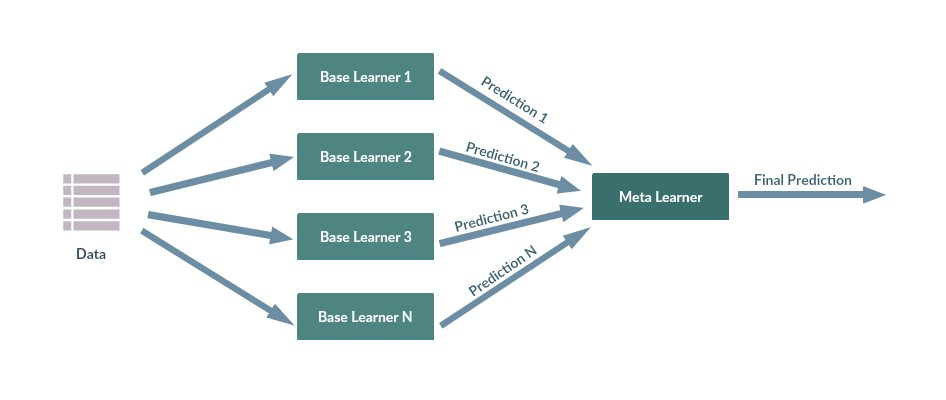

<div style="background-color:#d5eae9; padding:20px; font-size:15px">

**Ensemble** methods are used in machine learning to improve the accuracy of a model by combining predictions from multiple submodels. A simple form of ensemble method is called **"Voting Classifier"**. This method combines predictions from different types of models by taking a majority vote (in classification) or average prediction (in regression) of the individual model predictions.

The submodels or basemodels used in a Voting Classifier can be of different types, such as decision trees, SVMs, or logistic regression models. By combining predictions from different types of models, the Voting Classifier can often achieve higher accuracy than any individual model alone.

<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">🟢Base Voting Classifier</p>

In [204]:
# define the models to include in the ensemble
rf_model = RandomForestClassifier()
dt_model = DecisionTreeClassifier(max_depth=3)
svm_model = SVC(probability=True)

# create the ensemble model and fit it on the training set
ensemble_model = VotingClassifier(estimators=[('RF', rf_model), ('DT', dt_model), ('SVM', svm_model)], voting='soft')
ensemble_model.fit(X_train, y_train)

# make predictions on the test set and calculate and print the accuracy
predictions1 = ensemble_model.predict(X_test)
accuracy = metrics.accuracy_score(predictions1, y_test)
print('Accuracy of the Ensemble Model on the test set:', accuracy)

# calculate and print the mean cross-validated score of the ensemble model
cross_val_scores = cross_val_score(ensemble_model, X_train, y_train, cv=10, scoring='accuracy')
print('Cross-validated Score of the Ensemble Model:', cross_val_scores.mean())

Accuracy of the Ensemble Model on the test set: 0.89


<IPython.core.display.Javascript object>

Cross-validated Score of the Ensemble Model: 0.875625


#### 🎄Performance Metrics for Base Voting Classifier Model

In [205]:
BaseVoting_Classifier_result = metrics_calculator(y_test, predictions1, 'Base Voting Classifier')
BaseVoting_Classifier_result

,Base Voting Classifier
Accuracy,0.890000
Precision,0.890025
Recall,0.890000
F1-score,0.889794


<a id="1"></a>  
#### <p style="padding:5px;background-color:#d5eae9;margin:0;color:#c27849;font-family:newtimeroman;font-size:150%;text-align:center;border-radius: 50px 50px;overflow:hidden;font-weight:200">🟢Tuned Voting Classifier</p>

In [206]:
# define the models to include in the ensemble
rf_model = RandomForestClassifier(criterion='entropy', max_features='log2', n_estimators=500)
dt_model = DecisionTreeClassifier(ccp_alpha=0.0027, criterion='entropy', max_depth=7)
svm_model = SVC(C=10, kernel='linear', probability=True)

# create the ensemble model and fit it on the training set
ensemble_model1 = VotingClassifier(estimators=[('RF', rf_model), ('DT', dt_model), ('SVM', svm_model)], voting='soft')
ensemble_model1.fit(X_train, y_train)

# make predictions on the test set and calculate and print the accuracy
predictions2 = ensemble_model1.predict(X_test)
accuracy = metrics.accuracy_score(predictions2, y_test)
print('Accuracy of the Ensemble Model on the test set:', accuracy)

# calculate and print the mean cross-validated score of the ensemble model
cross_val_scores = cross_val_score(ensemble_model1, X_train, y_train, cv=10, scoring='accuracy')
print('Cross-validated Score of the Ensemble Model:', cross_val_scores.mean())

Accuracy of the Ensemble Model on the test set: 0.93


<IPython.core.display.Javascript object>

Cross-validated Score of the Ensemble Model: 0.911875


#### 🎄Performance Metrics for Tuned Voting Classifier Model

In [207]:
TunedVoting_Classifier_result = metrics_calculator(y_test, predictions2, 'Tuned Voting Classifier')
TunedVoting_Classifier_result

,Tuned Voting Classifier
Accuracy,0.930000
Precision,0.930926
Recall,0.930000
F1-score,0.930201


<center> <span style="font-family:newtimeroman"> <span style="padding:5px;display:fill;border-radius:20px 50px;background-color:#3a957f;font-size:200%;font-weight: 500;color:#254441;overflow:hidden;">ㅤ8.2 Bagging (Bagged Decision Tree)ㅤ</span>

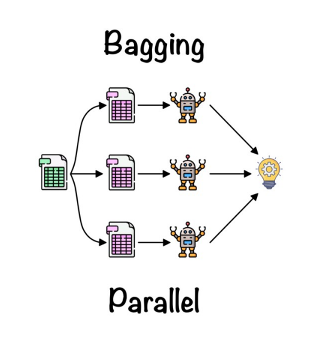

<div style="background-color:#d5eae9; padding:20px; font-size:15px">
    
**Bagging** is an ensemble learning method that involves training multiple classifiers on different subsets of the training data and combining their predictions to produce a final output. It is used to reduce variance and prevent overfitting. Bagging can be applied to any type of base classifier and has been used in various machine learning applications. However, it can be computationally expensive for large datasets and requires careful parameter tuning. Unlike the Voting Classifier, Bagging uses the same type of base classifier for each subset of the data.

#### 🎄Tuned Bagged Decision Tree

In [208]:
from sklearn.model_selection import GridSearchCV

# define the base decision tree model and the bagging model
base_model = DecisionTreeClassifier()
bagging_model = BaggingClassifier(base_estimator=base_model, random_state=0)

# create a dictionary of hyperparameters to search over
param_grid = {'base_estimator__max_depth': [4, 6],
              'base_estimator__min_samples_split': [4, 6],
              'n_estimators': [50, 100],
              'max_samples': [0.7, 1.0]}

# use GridSearchCV to search over the hyperparameter space
grid_search = GridSearchCV(bagging_model, param_grid, cv=5, scoring='accuracy')

# fit the grid search on the data
grid_search.fit(X_train, y_train)

# Set the clf to the best combination of parameters
Bagging = grid_search.best_estimator_

# print the best hyperparameters and corresponding score
print("Best hyperparameters: ", grid_search.best_params_)

Best hyperparameters:  {'base_estimator__max_depth': 6, 'base_estimator__min_samples_split': 4, 'max_samples': 1.0, 'n_estimators': 50}


#### 🎄Train Tuned  Model

In [209]:
# fit the bagging model on the training set
Bagging.fit(X_train, y_train)

# make predictions on the test set and calculate and print the accuracy
predictions3 = Bagging.predict(X_test)
accuracy = metrics.accuracy_score(predictions3, y_test)
print('Accuracy of the Bagged Decision Tree Model on the test set:', accuracy)

# calculate and print the mean cross-validated score of the bagging model
cross_val_scores = cross_val_score(Bagging, X_train, y_train, cv=10, scoring='accuracy')
print('Cross-validated Score of the Bagged Decision Tree Model:', cross_val_scores.mean())

Accuracy of the Bagged Decision Tree Model on the test set: 0.875


<IPython.core.display.Javascript object>

Cross-validated Score of the Bagged Decision Tree Model: 0.8787500000000001


#### 🎄Performance Metrics for Tuned Bagged Decision Tree Model

In [210]:
Bagged_DecisionTree_result = metrics_calculator(y_test, predictions3, 'Tuned Bagged Decision Tree')
Bagged_DecisionTree_result

,Tuned Bagged Decision Tree
Accuracy,0.875000
Precision,0.875674
Recall,0.875000
F1-score,0.874772


<center> <span style="font-family:newtimeroman"> <span style="padding:5px;display:fill;border-radius:20px 50px;background-color:#3a957f;font-size:200%;font-weight: 500;color:#254441;overflow:hidden;">ㅤ8.3. Boosting (AdaBoost, Gradient Boosting & XGBoost)ㅤ</span>

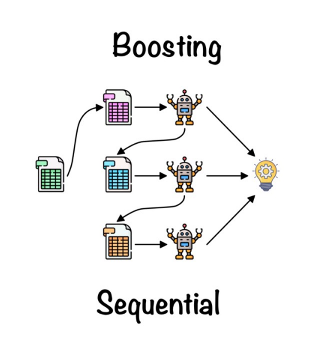

<div style="background-color:#d5eae9; padding:20px; font-size:15px">
    
**Boosting** is an ensembling technique which uses sequential learning of classifiers. It is a step by step enhancement of a weak model. Boosting works as follows:

A model is first trained on the complete dataset. Now the model will get some instances right while some wrong. Now in the next iteration, the learner will focus more on the wrongly predicted instances or give more weight to it. Thus it will try to predict the wrong instance correctly. Now this iterative process continous, and new classifers are added to the model until the limit is reached on the accuracy.

<center> <span style="font-family:newtimeroman"> <span style="padding:5px;display:fill;border-radius:20px 50px;background-color:#3a957f;font-size:200%;font-weight: 500;color:#254441;overflow:hidden;">ㅤ8.3.1. AdaBoost (Adaptive Boosting)ㅤ</span>

#### 🎄Tuned AdaBoost (Adaptive Boosting)

In [211]:
from sklearn.model_selection import GridSearchCV

# define the AdaBoost model with default hyperparameters
ada = AdaBoostClassifier(base_estimator=DecisionTreeClassifier(), random_state=0)

# define the hyperparameters to tune
params = {'n_estimators': [200, 500, 900], 'learning_rate': [0.1, 0.01, 1]}

# base_estimator__max_depth = [1, 2, 3, 4, 5]

# define the grid search using cross validation
grid_search = GridSearchCV(estimator=ada, param_grid=params, cv=10, scoring='accuracy')

# fit the grid search on the data
grid_search.fit(X_train, y_train)

# Set the clf to the best combination of parameters
AdaBoost = grid_search.best_estimator_

# print the best hyperparameters and their corresponding score
print("Best parameters: ", grid_search.best_params_)

Best parameters:  {'learning_rate': 0.1, 'n_estimators': 200}


#### 🎄Train Tuned  Model

In [212]:
# fit the AdaBoost model on the training set
AdaBoost.fit(X_train, y_train)

# make predictions on the test set and calculate and print the accuracy
predictions4 = AdaBoost.predict(X_test)
accuracy = metrics.accuracy_score(predictions4, y_test)
print('Accuracy of the AdaBoost on the test set:', accuracy)

# calculate and print the mean cross-validated score of the AdaBoost model
cross_val_scores = cross_val_score(AdaBoost, X_train, y_train, cv=10, scoring='accuracy')
print('The Cross-validated Score for AdaBoost is:', cross_val_scores.mean())

Accuracy of the AdaBoost on the test set: 0.835


<IPython.core.display.Javascript object>

The Cross-validated Score for AdaBoost is: 0.8206249999999999


#### 🎄Performance Metrics for Tuned AdaBoost Model

In [213]:
AdaBoost_result = metrics_calculator(y_test, predictions4, 'Tuned AdaBoost')
AdaBoost_result

,Tuned AdaBoost
Accuracy,0.835
Precision,0.835
Recall,0.835
F1-score,0.835


<center> <span style="font-family:newtimeroman"> <span style="padding:5px;display:fill;border-radius:20px 50px;background-color:#3a957f;font-size:200%;font-weight: 500;color:#254441;overflow:hidden;">ㅤ8.3.2. Stochastic Gradient Boostingㅤ</span>

#### 🎄Tuned Stochastic Gradient Boosting

In [214]:
# Define the GradientBoosting model with default hyperparameters
grad = GradientBoostingClassifier(learning_rate=0.1, random_state=0)

# Define the hyperparameters to tune
parameters = {'n_estimators': [500, 900], 'max_depth': [5, 7]}

#learning_rate = [0.01, 0.1]
#min_samples_split = [2, 5, 10]
#min_samples_leaf = [1, 2, 4]

# Create the grid search object
grid_search = GridSearchCV(grad, parameters, cv=10, scoring='accuracy')

# fit the grid search on the data
grid_search.fit(X_train, y_train)

# Set the clf to the best combination of parameters
Gradient_Boosting = grid_search.best_estimator_

# Print the results
print('Best parameters:', grid_search.best_params_)

Best parameters: {'max_depth': 5, 'n_estimators': 500}


#### 🎄Train Tuned  Model

In [215]:
# fit the GradientBoosting model on the training set
Gradient_Boosting.fit(X_train, y_train)

# make predictions on the test set and calculate and print the accuracy
predictions5 = Gradient_Boosting.predict(X_test)
accuracy = metrics.accuracy_score(predictions5, y_test)
print('Accuracy of the GradientBoosting on the test set:', accuracy)

# calculate and print the mean cross-validated score of the GradientBoosting model
cross_val_scores = cross_val_score(Gradient_Boosting, X_train, y_train, cv=10, scoring='accuracy')
print('The Cross-validated Score for GradientBoosting is:', cross_val_scores.mean())

Accuracy of the GradientBoosting on the test set: 0.91


<IPython.core.display.Javascript object>

The Cross-validated Score for GradientBoosting is: 0.9081250000000001


#### 🎄Performance Metrics for Tuned Gradient Boosting Model

In [216]:
GradientBoosting_result = metrics_calculator(y_test, predictions5, 'Tuned Gradient Boosting')
GradientBoosting_result

,Tuned Gradient Boosting
Accuracy,0.910000
Precision,0.911786
Recall,0.910000
F1-score,0.910402


<center> <span style="font-family:newtimeroman"> <span style="padding:5px;display:fill;border-radius:20px 50px;background-color:#3a957f;font-size:200%;font-weight: 500;color:#254441;overflow:hidden;">ㅤ8.3.3. XGBoostㅤ</span>

#### 🎄Tuned XGBoost

In [217]:
# Create XGBoost classifier
xgboost = xg.XGBClassifier(objective='multi:softmax', learning_rate=0.1)

# Set hyperparameters to tune
param_grid = {'n_estimators': [500, 900], 'max_depth': [5, 7]}

#learning_rate = [0.01, 0.1]
#subsample = [0.6, 0.8, 1.0]
#colsample_bytree = [0.6, 0.8, 1.0]
#gamma = [0, 1, 5]

# Use GridSearchCV for hyperparameter tuning
grid_search = GridSearchCV(estimator=xgboost, param_grid=param_grid, scoring='accuracy', cv=10)

# fit the grid search on the data
grid_search.fit(X_train, y_train)

# Set the clf to the best combination of parameters
Xgboost = grid_search.best_estimator_

# Print results
print('The best hyperparameters are:', grid_search.best_params_)

The best hyperparameters are: {'max_depth': 7, 'n_estimators': 500}


#### 🎄Train Tuned  Model

In [218]:
# fit the XGBoost model on the training set
Xgboost.fit(X_train, y_train)

# make predictions on the test set and calculate and print the accuracy
predictions6 = Xgboost.predict(X_test)
accuracy = metrics.accuracy_score(predictions6, y_test)
print('Accuracy of the GradientBoosting on the test set:', accuracy)

# calculate and print the mean cross-validated score of the XGBoost model
cross_val_scores = cross_val_score(Xgboost, X_train, y_train, cv=10, scoring='accuracy')
print('The Cross-validated Score for GradientBoosting is:', cross_val_scores.mean())

Accuracy of the GradientBoosting on the test set: 0.9125


<IPython.core.display.Javascript object>

The Cross-validated Score for GradientBoosting is: 0.915


#### 🎄Performance Metrics for Tuned XGBoost Model

In [219]:
XGBoost_result = metrics_calculator(y_test, predictions6, 'Tuned XGBoost')
XGBoost_result

,Tuned XGBoost
Accuracy,0.912500
Precision,0.913920
Recall,0.912500
F1-score,0.912827


<center> <span style="font-family:newtimeroman"> <span style="padding:5px;display:fill;border-radius:20px 50px;background-color:#c27849;font-size:200%;font-weight: 500;color:#254441;overflow:hidden;">ㅤConclusion of Ensembled Modelsㅤ</span>

In [220]:
Ensemble_Conclusion = pd.concat([BaseVoting_Classifier_result, TunedVoting_Classifier_result, Bagged_DecisionTree_result, AdaBoost_result, GradientBoosting_result, XGBoost_result], axis=1)
Ensemble_Conclusion

,Base Voting Classifier,Tuned Voting Classifier,Tuned Bagged Decision Tree,Tuned AdaBoost,Tuned Gradient Boosting,Tuned XGBoost
Accuracy,0.890000,0.930000,0.875000,0.835,0.910000,0.912500
Precision,0.890025,0.930926,0.875674,0.835,0.911786,0.913920
Recall,0.890000,0.930000,0.875000,0.835,0.910000,0.912500
F1-score,0.889794,0.930201,0.874772,0.835,0.910402,0.912827


<div style="background-color:#d5eae9; padding:20px; font-size:15px">

The order of the ✅**Best Models** from top to bottom:

|       | **Model (Best from 1 to 6)** |
| :---  |   :---   |       
| **1** | Tuned Voting Classifier✅ |                 
| **2** | Tuned XGBoost |                         
| **3** | Tuned Gradient Boosting |
| **4** | Base Voting Classifier |
| **5** | Tuned Bagged DecisionTree |                        
| **6** | Tuned AdaBoost |                      

<div style="background-color:#e9f5f0; padding:20px; font-size:15px">

**Explanations:**
- We got the **Highest Accuracy** for **✅Tuned Voting Classifier**.

### Evaluation of Best Ensembled Model

#### 🎄Predict Best Ensembled Model X-test

In [222]:
# Tuned Voting Classifier
y_pred_tuned_ensemble = ensemble_model1.predict(X_test)

#### 🎄Confusion Matrix for the Best Model of Ensemble Learning

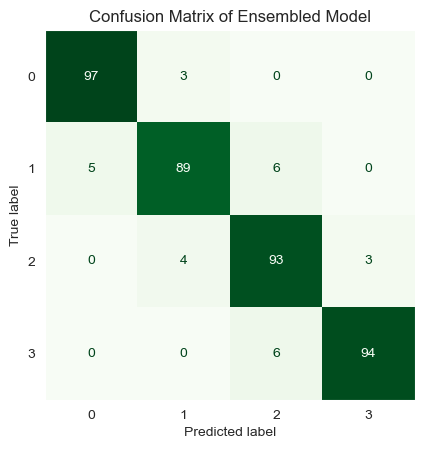

In [223]:
# Tuned Voting Classifier
ConfusionMatrixDisplay.from_estimator(ensemble_model1, X_test, y_test, colorbar=False, cmap='Greens')
plt.title('Confusion Matrix of Best Ensembled Model')
plt.grid(False)

#### 🎄Classification Report for the Best Model of Ensemble Learning

In [224]:
# Tuned Voting Classifier
print(classification_report(y_test, y_pred_tuned_ensemble))

              precision    recall  f1-score   support

           0       0.95      0.97      0.96       100
           1       0.93      0.89      0.91       100
           2       0.89      0.93      0.91       100
           3       0.97      0.94      0.95       100

    accuracy                           0.93       400
   macro avg       0.93      0.93      0.93       400
weighted avg       0.93      0.93      0.93       400



#### 🎄Roc Curve for the Best Model of Ensemble Learning

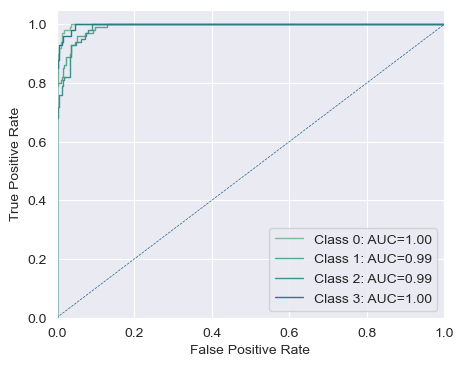

In [225]:
# Tuned Voting Classifier
y_Pred_prob = ensemble_model1.predict_proba(X_test)

def roc_curve_plot(y_actual, y_predicted_probs, figsize=(5, 4), title=None, legend_loc='best'):

    # Compute ROC curve and ROC area for each class
    fpr = {}
    tpr = {}
    thres = {}
    roc_auc = {}

    n_class = y_predicted_probs.shape[1]
    for i in range(n_class):
        fpr[i], tpr[i], thres[i] = roc_curve(y_actual == i, y_predicted_probs[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Create a figure and plot the ROC curve for each class
    plt.figure(figsize=figsize)
    for i in range(n_class):
        plt.plot(fpr[i], tpr[i], linewidth=1, label='Class {}: AUC={:.2f}'.format(i, roc_auc[i]))

    # Add diagonal line and axis labels
    plt.plot([0, 1], [0, 1], '--', linewidth=0.5)
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')

    # Set axis limits and add title and legend
    plt.xlim([0, 1])
    plt.ylim([0, 1.05])
    if title is not None:
        plt.title(title)
    plt.legend(loc=legend_loc)

    # Show the plot
    plt.show()
        
roc_curve_plot(y_test, y_Pred_prob)

<div <h3 style="border-radius:10px;border:#034914 solid;padding: 15px;background-color:#d5eae9;font-size:90%;text-align:center"> </h3>
      <h4 class="alert-heading">Thank you for taking the time to consider this matter</h4>
  <hr> 
  <h4><b>Author:</b> Ali Farahmandfar </h4>
  <hr>
    
<center> <strong> If you enjoyed this Notebook, please give it an upvote. </strong>
    
<center> <strong> 💫Best Wishes💫 </strong>